In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import cv2
from tqdm import tqdm
import random
import shutil
import glob
from pathlib import Path
import yaml

In [2]:
from ultralytics import YOLO


In [3]:
import onnxruntime as ort
from openvino import Core
import torch

2025-11-17 11:12:06.794548917 [W:onnxruntime:Default, device_discovery.cc:164 DiscoverDevicesForPlatform] GPU device discovery failed: device_discovery.cc:89 ReadFileContents Failed to open file: "/sys/class/drm/card1/device/vendor"


# Kết quả training

# Inference

In [4]:
data_yaml = "./Dataset/Detect/data_detect_vntsr/data.yaml"

In [7]:
def test_inference_preview(model_path, test_dir, max_images=5, imgsz=640, conf=0.4):
    """
    Hàm inference nhanh (không lưu file), chọn ngẫu nhiên vài ảnh test và hiển thị trực tiếp.
    - model_path: đường dẫn file .pt
    - test_dir: thư mục chứa ảnh test
    - max_images: số ảnh hiển thị
    - imgsz: kích thước resize
    - conf: ngưỡng confidence threshold
    """
    print(f"\n🚀 Loading model from: {model_path}")
    model = YOLO(model_path)

    # Lấy ngẫu nhiên vài ảnh test
    all_images = glob.glob(os.path.join(test_dir, "*"))
    if len(all_images) == 0:
        print("⚠️ Không tìm thấy ảnh trong thư mục test!")
        return
    sample_images = random.sample(all_images, min(max_images, len(all_images)))
    print(f"🖼️  Running inference on {len(sample_images)} random images...")

    # Chạy predict (không lưu file)
    results = model.predict(
        source=sample_images,
        imgsz=imgsz,
        conf=conf,
        save=False,
        verbose=False
    )

    # Hiển thị kết quả
    for i, result in enumerate(results):
        img_plot = result.plot()  # trả về numpy array có bounding boxes vẽ sẵn
        plt.figure(figsize=(10, 8))
        plt.imshow(img_plot[..., ::-1])  # BGR -> RGB
        plt.axis("off")
        plt.title(f"Prediction {i+1}: {os.path.basename(sample_images[i])}")
        plt.show()


🚀 Loading model from: ./weight/yolo5.pt
🖼️  Running inference on 2 random images...


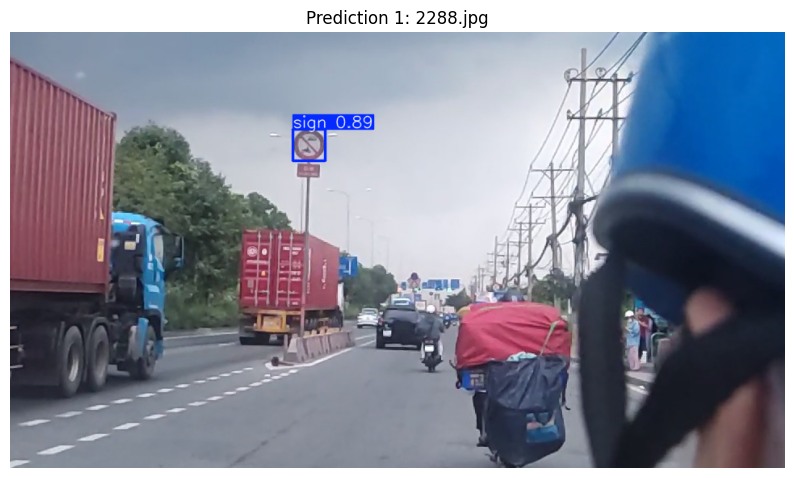

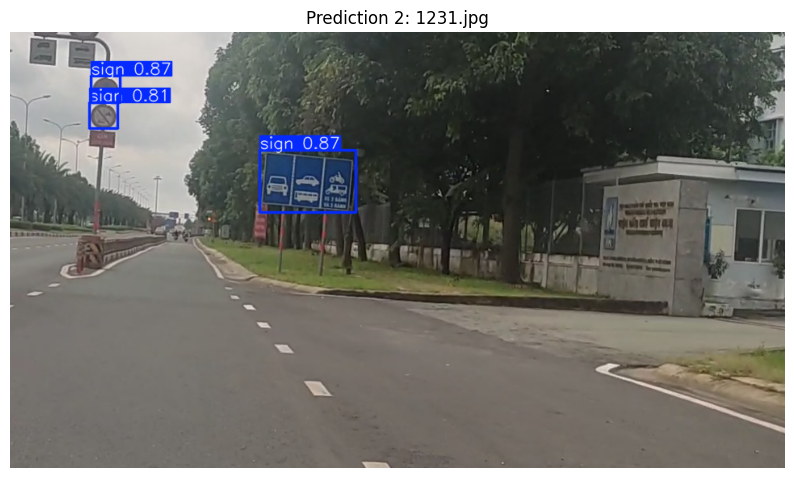

In [8]:
test_inference_preview(
    model_path="./weight/yolo5.pt",
    test_dir="./Dataset/Detect/data_detect_vntsr/images/test",
    max_images=2,
    conf=0.4
)

# Evaluation

In [9]:
import time
import os
device = "cpu"

In [10]:
def evaluate_model(model_path, data_yaml, device, eval_type="Self", imgsz=640, batch=4):
    """
    Đánh giá model YOLO (.pt) trên dataset bất kỳ.
    - eval_type: 'Self' hoặc 'Cross'
    - Tính các chỉ số: Precision, Recall, F1, Accuracy (xấp xỉ), mAP@50, mAP@50-95, thời gian eval & inference.
    """
    print(f"\n📈 [{eval_type}] Evaluating: {os.path.basename(model_path)} on {data_yaml}")
    model = YOLO(model_path)
    model.to(device)

    # === Validation phase ===
    t0 = time.time()
    metrics = model.val(data=data_yaml, imgsz=imgsz, batch=batch)
    eval_time = time.time() - t0

    # === YOLO built-in metrics ===
    map50 = round(metrics.box.map50, 4)
    map95 = round(metrics.box.map, 4)
    prec_yolo = round(metrics.box.mp, 4)
    recall_yolo = round(metrics.box.mr, 4)
    f1_yolo = round(2 * (prec_yolo * recall_yolo) / (prec_yolo + recall_yolo + 1e-9), 4)
    acc_yolo = round((prec_yolo + recall_yolo) / 2, 4)  # xấp xỉ accuracy

    # === Inference benchmark ===
    dummy = torch.randn(1, 3, imgsz, imgsz).to(device)
    model.model.to(device)
    t_inf = time.time()
    for _ in range(20):
        _ = model.model(dummy)
    infer_time = (time.time() - t_inf) / 20
    fps = round(1 / infer_time, 2)

    # === Trả về kết quả ===
    return {
        "Model Name": os.path.basename(model_path).replace(".pt", ""),
        "Eval Type": eval_type,
        "Precision": prec_yolo,
        "Recall": recall_yolo,
        "F1-score": f1_yolo,
        "Accuracy (approx)": acc_yolo,
        "mAP@50": map50,
        "mAP@50-95": map95,
        "Eval Time (s)": round(eval_time, 2),
        "Infer Time (s/img)": round(infer_time, 4),
        "FPS": fps
    }


In [ ]:
# === Dataset ===
dataset1 = "./Dataset/Detect/data_detect_vntsr/data.yaml"

# === Danh sách model cần test ===
model_paths = [
    "./weight/yolo5.pt",
    "./weight/yolo8.pt",
    "./weight/yolo11.pt",
]

# === Evaluate tất cả model ===
eval_records = []
for model_path in model_paths:
    result = evaluate_model(model_path, dataset1, device="cpu", eval_type="Self")
    eval_records.append(result)

# === Lưu kết quả ra file CSV ===
df_result = pd.DataFrame(eval_records)
output_csv = "./Eval/eval_v5v8v11pt.csv"
os.makedirs(os.path.dirname(output_csv), exist_ok=True)
df_result.to_csv(output_csv, index=False)

print("\n✅ Đã lưu kết quả tại:", output_csv)
display(df_result)


# Convert Model

## Viz YOLO

In [11]:
def visualize_predictions_yolo(
    onnx_path,
    data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    save_dir="viz",
):
    """
    Visualize predictions (YOLO .onnx) vs ground truth (bbox trả về đúng kích thước gốc)
    """
    os.makedirs(save_dir, exist_ok=True)

    print(f"\n🎨 Visualizing {num_samples} images from {os.path.basename(onnx_path)}")
    print(f"📊 Confidence threshold: {conf_threshold}")

    # --- Load YOLO model (ONNX) ---
    model = YOLO(onnx_path, task='detect')
    print(f"✅ Loaded YOLO ONNX model successfully: {onnx_path}")

    # --- Load dataset config ---
    with open(data_yaml, 'r') as f:
        data_config = yaml.safe_load(f)

    dataset_root = Path(data_yaml).parent
    test_path = data_config.get('test', 'test')

    test_images_path = dataset_root / data_config.get('val', 'test/images')
    test_labels_path = dataset_root / data_config.get('val', 'test/labels')

    # --- Sample random images ---
    image_files = list(test_images_path.glob('*.jpg')) + list(test_images_path.glob('*.png'))
    sample_images = random.sample(image_files, min(num_samples, len(image_files)))

    # --- Create figure ---
    fig, axes = plt.subplots(len(sample_images), 2, figsize=(16, 6 * len(sample_images)))
    if len(sample_images) == 1:
        axes = axes.reshape(1, -1)

    for idx, img_path in enumerate(sample_images):
        img = cv2.imread(str(img_path))
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        orig_h, orig_w = img.shape[:2]

        # === Load Ground Truth ===
        label_path = test_labels_path / (img_path.stem + '.txt')
        gt_boxes = []
        if label_path.exists():
            with open(label_path, 'r') as f:
                for line in f:
                    cls, xc, yc, w, h = map(float, line.strip().split()[:5])
                    gt_boxes.append((xc, yc, w, h))

        # === Run YOLO ONNX inference ===
        results = model(img, conf=conf_threshold)
        preds = results[0].boxes

        boxes_xyxy = preds.xyxy.cpu().numpy() if preds is not None else np.empty((0, 4))
        scores = preds.conf.cpu().numpy() if preds is not None else np.empty((0,))

        # === Visualization ===
        ax1, ax2 = axes[idx]
        ax1.imshow(img_rgb)
        ax1.set_title(f'Image\n{img_path.name}', fontsize=12, fontweight='bold')
        ax1.axis('off')

        # Ground truth (green)
        for (xc, yc, w, h) in gt_boxes:
            x1 = int((xc - w / 2) * orig_w)
            y1 = int((yc - h / 2) * orig_h)
            x2 = int((xc + w / 2) * orig_w)
            y2 = int((yc + h / 2) * orig_h)
            ax1.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                        fill=False, edgecolor='lime', linewidth=3))
            ax1.text(x1, y1 - 5, 'GT', color='lime', fontsize=10,
                     bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.6))

        # Predictions (red)
        ax2.imshow(img_rgb)
        ax2.set_title(f'Prediction (conf>{conf_threshold})', fontsize=12, fontweight='bold')
        ax2.axis('off')

        for box, score in zip(boxes_xyxy, scores):
            x1, y1, x2, y2 = map(int, box)
            ax2.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                        fill=False, edgecolor='red', linewidth=3))
            ax2.text(x1, y1 - 5, f'{score:.2f}', color='red', fontsize=10,
                     bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.6))

    plt.tight_layout()
    save_path = os.path.join(save_dir, f"{Path(onnx_path).stem}_visualization.png")
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    plt.show()
    print(f"✅ Saved visualization to: {save_path}")
    return save_path


In [12]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import yaml
import random
from pathlib import Path
import onnxruntime as ort
import time


def letterbox(img, new_shape=(640, 640), color=(114, 114, 114)):
    """
    Resize and pad image to new_shape với letterbox
    """
    shape = img.shape[:2]  # current shape [height, width]
    if isinstance(new_shape, int):
        new_shape = (new_shape, new_shape)
    
    # Scale ratio (new / old)
    r = min(new_shape[0] / shape[0], new_shape[1] / shape[1])
    
    # Compute padding
    new_unpad = int(round(shape[1] * r)), int(round(shape[0] * r))
    dw, dh = new_shape[1] - new_unpad[0], new_shape[0] - new_unpad[1]  # wh padding
    
    dw /= 2  # divide padding into 2 sides
    dh /= 2
    
    if shape[::-1] != new_unpad:  # resize
        img = cv2.resize(img, new_unpad, interpolation=cv2.INTER_LINEAR)
    
    top, bottom = int(round(dh - 0.1)), int(round(dh + 0.1))
    left, right = int(round(dw - 0.1)), int(round(dw + 0.1))
    img = cv2.copyMakeBorder(img, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)
    
    return img, r, (dw, dh)


def preprocess_image(img, input_size=(640, 640)):
    """
    Preprocess image cho ONNX model
    img: BGR image từ cv2.imread
    input_size: (height, width) của model input
    """
    # Letterbox resize
    img_resized, ratio, (dw, dh) = letterbox(img, new_shape=input_size)
    
    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)
    
    # Normalize to [0, 1]
    img_normalized = img_rgb.astype(np.float32) / 255.0
    
    # HWC to CHW
    img_transposed = img_normalized.transpose(2, 0, 1)
    
    # Add batch dimension
    img_batch = np.expand_dims(img_transposed, axis=0)
    
    return img_batch, ratio, (dw, dh)


def postprocess_output(output, orig_shape, ratio, pad, conf_threshold=0.25, iou_threshold=0.45):
    """
    Postprocess ONNX output về bounding boxes (có thêm NMS)
    """
    # Kiểm tra shape và transpose nếu cần
    if output.shape[-1] == 84:
        output = output.transpose(0, 2, 1)  # (1, 8400, 84) -> (1, 84, 8400)

    predictions = output[0]  # (84, 8400)
    boxes = predictions[:4].T  # (8400, 4)
    scores = predictions[4:].T  # (8400, num_classes)

    # Lấy max score và class cho mỗi box
    class_scores = np.max(scores, axis=1)
    class_ids = np.argmax(scores, axis=1)

    # Filter theo confidence threshold
    mask = class_scores > conf_threshold
    boxes = boxes[mask]
    scores = class_scores[mask]
    class_ids = class_ids[mask]

    # Convert từ xywh → xyxy
    x_center, y_center, width, height = boxes[:, 0], boxes[:, 1], boxes[:, 2], boxes[:, 3]
    x1 = x_center - width / 2
    y1 = y_center - height / 2
    x2 = x_center + width / 2
    y2 = y_center + height / 2
    boxes_xyxy = np.stack([x1, y1, x2, y2], axis=1)

    # Scale boxes về kích thước ảnh gốc
    boxes_xyxy[:, [0, 2]] -= pad[0]
    boxes_xyxy[:, [1, 3]] -= pad[1]
    boxes_xyxy /= ratio

    # Clip boxes trong giới hạn ảnh
    boxes_xyxy[:, [0, 2]] = np.clip(boxes_xyxy[:, [0, 2]], 0, orig_shape[1])
    boxes_xyxy[:, [1, 3]] = np.clip(boxes_xyxy[:, [1, 3]], 0, orig_shape[0])

    # =======================
    # 📦 Non-Maximum Suppression (NMS)
    # =======================
    keep_boxes = []
    for cls in np.unique(class_ids):
        # Lọc box theo class
        cls_mask = class_ids == cls
        b = boxes_xyxy[cls_mask]
        s = scores[cls_mask]

        # Sort theo score giảm dần
        order = s.argsort()[::-1]
        b = b[order]
        s = s[order]

        keep = []
        while len(b) > 0:
            i = 0  # chọn box có score cao nhất
            keep.append(order[i])

            if len(b) == 1:
                break

            # IoU với các box còn lại
            xx1 = np.maximum(b[i, 0], b[1:, 0])
            yy1 = np.maximum(b[i, 1], b[1:, 1])
            xx2 = np.minimum(b[i, 2], b[1:, 2])
            yy2 = np.minimum(b[i, 3], b[1:, 3])

            inter_w = np.maximum(0.0, xx2 - xx1)
            inter_h = np.maximum(0.0, yy2 - yy1)
            inter_area = inter_w * inter_h

            area_i = (b[i, 2] - b[i, 0]) * (b[i, 3] - b[i, 1])
            area_others = (b[1:, 2] - b[1:, 0]) * (b[1:, 3] - b[1:, 1])
            union = area_i + area_others - inter_area

            iou = inter_area / (union + 1e-6)

            # Giữ box có IoU < threshold
            keep_idx = np.where(iou < iou_threshold)[0] + 1
            b = b[keep_idx]
            s = s[keep_idx]
            order = order[keep_idx]

        keep_boxes.extend(keep)

    keep_boxes = np.array(keep_boxes)
    boxes_xyxy = boxes_xyxy[keep_boxes]
    scores = scores[keep_boxes]
    class_ids = class_ids[keep_boxes]

    return boxes_xyxy, scores, class_ids


def visualize_predictions_yolo(
    onnx_path,
    data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    save_dir="viz",
    input_size=(640, 640),  # Model input size (height, width)
):
    """
    Visualize predictions (YOLO ONNX với ONNX Runtime) vs ground truth
    """
    os.makedirs(save_dir, exist_ok=True)
    print(f"\n🎨 Visualizing {num_samples} images from {os.path.basename(onnx_path)}")
    print(f"📊 Confidence threshold: {conf_threshold}")
    print(f"📐 Model input size: {input_size}")
    
    # --- Load ONNX model with ONNX Runtime ---
    print(f"⏳ Loading ONNX model with ONNX Runtime...")
    session = ort.InferenceSession(onnx_path, providers=['CPUExecutionProvider'])
    input_name = session.get_inputs()[0].name
    print(f"✅ Loaded ONNX model successfully")
    print(f"   Input name: {input_name}")
    print(f"   Input shape: {session.get_inputs()[0].shape}")
    print(f"   Output shape: {session.get_outputs()[0].shape}")
    
    # --- Load dataset config ---
    with open(data_yaml, 'r') as f:
        data_config = yaml.safe_load(f)
    
    dataset_root = Path(data_yaml).parent
    test_images_path = dataset_root / data_config.get('val', 'valid/images')
    test_labels_path = dataset_root / data_config.get('val', 'valid/labels')
    
    # --- Sample random images ---
    image_files = list(test_images_path.glob('*.jpg')) + list(test_images_path.glob('*.png'))
    sample_images = random.sample(image_files, min(num_samples, len(image_files)))
    
    # --- Create figure ---
    fig, axes = plt.subplots(len(sample_images), 2, figsize=(16, 6 * len(sample_images)))
    if len(sample_images) == 1:
        axes = axes.reshape(1, -1)
    
    # Track inference times
    inference_times = []
    print(f"\n⏱️  Processing images...")
    
    for idx, img_path in enumerate(sample_images):
        img = cv2.imread(str(img_path))
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        orig_h, orig_w = img.shape[:2]
        
        # === Load Ground Truth ===
        label_path = test_labels_path / (img_path.stem + '.txt')
        gt_boxes = []
        if label_path.exists():
            with open(label_path, 'r') as f:
                for line in f:
                    cls, xc, yc, w, h = map(float, line.strip().split()[:5])
                    gt_boxes.append((xc, yc, w, h))
        
        # === Run ONNX Runtime inference ===
        # Preprocess
        start_preprocess = time.time()
        input_tensor, ratio, pad = preprocess_image(img, input_size=input_size)
        preprocess_time = time.time() - start_preprocess
        
        # Inference
        start_inference = time.time()
        outputs = session.run(None, {input_name: input_tensor})
        inference_time = time.time() - start_inference
        inference_times.append(inference_time)
        
        # Postprocess
        start_postprocess = time.time()
        boxes_xyxy, scores, class_ids = postprocess_output(
            outputs[0], 
            (orig_h, orig_w), 
            ratio, 
            pad, 
            conf_threshold
        )
        postprocess_time = time.time() - start_postprocess
        
        total_time = preprocess_time + inference_time + postprocess_time
        
        # === Visualization ===
        ax1, ax2 = axes[idx]
        
        # Ground Truth
        ax1.imshow(img_rgb)
        ax1.set_title(f'Ground Truth\n{img_path.name}', fontsize=12, fontweight='bold')
        ax1.axis('off')
        
        for (xc, yc, w, h) in gt_boxes:
            x1 = int((xc - w / 2) * orig_w)
            y1 = int((yc - h / 2) * orig_h)
            x2 = int((xc + w / 2) * orig_w)
            y2 = int((yc + h / 2) * orig_h)
            ax1.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                        fill=False, edgecolor='lime', linewidth=3))
            ax1.text(x1, y1 - 5, 'GT', color='lime', fontsize=10,
                     bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.6))
        
        # Predictions
        ax2.imshow(img_rgb)
        timing_info = (f'Prediction (conf>{conf_threshold})\n'
                      f'Detected: {len(boxes_xyxy)} | '
                      f'Inference: {inference_time*1000:.1f}ms\n'
                      f'Pre: {preprocess_time*1000:.1f}ms | '
                      f'Post: {postprocess_time*1000:.1f}ms | '
                      f'Total: {total_time*1000:.1f}ms')
        ax2.set_title(timing_info, fontsize=10, fontweight='bold')
        ax2.axis('off')
        
        for box, score in zip(boxes_xyxy, scores):
            x1, y1, x2, y2 = map(int, box)
            ax2.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                        fill=False, edgecolor='red', linewidth=3))
            ax2.text(x1, y1 - 5, f'{score:.2f}', color='red', fontsize=10,
                     bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.6))
    
    plt.tight_layout()
    save_path = os.path.join(save_dir, f"{Path(onnx_path).stem}_visualization.png")
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    plt.show()
    
    # Print timing statistics
    avg_inference = np.mean(inference_times) * 1000
    std_inference = np.std(inference_times) * 1000
    min_inference = np.min(inference_times) * 1000
    max_inference = np.max(inference_times) * 1000
    fps = 1 / np.mean(inference_times)
    
    print(f"\n⏱️  Inference Timing Statistics ({len(inference_times)} images):")
    print(f"   Average: {avg_inference:.2f}ms (±{std_inference:.2f}ms)")
    print(f"   Min: {min_inference:.2f}ms | Max: {max_inference:.2f}ms")
    print(f"   FPS: {fps:.1f}")
    print(f"✅ Saved visualization to: {save_path}")
    
    return save_path


# Example usage:
# visualize_predictions_yolo(
#     onnx_path="path/to/model.onnx",
#     data_yaml="path/to/data.yaml",
#     num_samples=6,
#     conf_threshold=0.25,
#     input_size=(640, 640)  # hoặc (640, 1280) tùy model của bạn
# )

## ONNX

### YOLOv5n

In [13]:
pt_path = "./weight/yolo5.pt"
work_dir = "convert/model/yolo5"
onnx_path = os.path.join(work_dir, "yolo5.onnx")

# --- Tạo thư mục đích ---
os.makedirs(work_dir, exist_ok=True)

# --- Copy model .pt ra thư mục working ---
pt_copy_path = os.path.join(work_dir, "yolo5.pt")
shutil.copy(pt_path, pt_copy_path)

# --- Tải model yolo5 ---
yolo5 = YOLO(pt_copy_path)

# --- Export sang ONNX ---
yolo5.export(format="onnx", imgsz=640, dynamic=True)

# --- Tìm file ONNX được tạo ra ---
for f in os.listdir(work_dir):
    if f.endswith(".onnx"):
        export_file = os.path.join(work_dir, f)
        os.rename(export_file, onnx_path)
        break

# --- Xóa file .pt ---
os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
YOLOv5n summary (fused): 84 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs

PyTorch: starting from 'convert/model/yolo5/yolo5.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.0 MB)

ONNX: starting export with onnx 1.19.1 opset 22...
ONNX: slimming with onnxslim 0.1.74...
ONNX: export success ✅ 6.0s, saved as 'convert/model/yolo5/yolo5.onnx' (10.0 MB)

Export complete (7.8s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo5
Predict:         yolo predict task=detect model=convert/model/yolo5/yolo5.onnx imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo5/yolo5.onnx imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 5 images from yolo5.onnx
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
⏳ Loading ONNX model with ONNX Runtime...
✅ Loaded ONNX model successfully
   Input name: images
   Input shape: ['batch', 3, 'height', 'width']
   Output shape: ['batch', 5, 'anchors']

⏱️  Processing images...


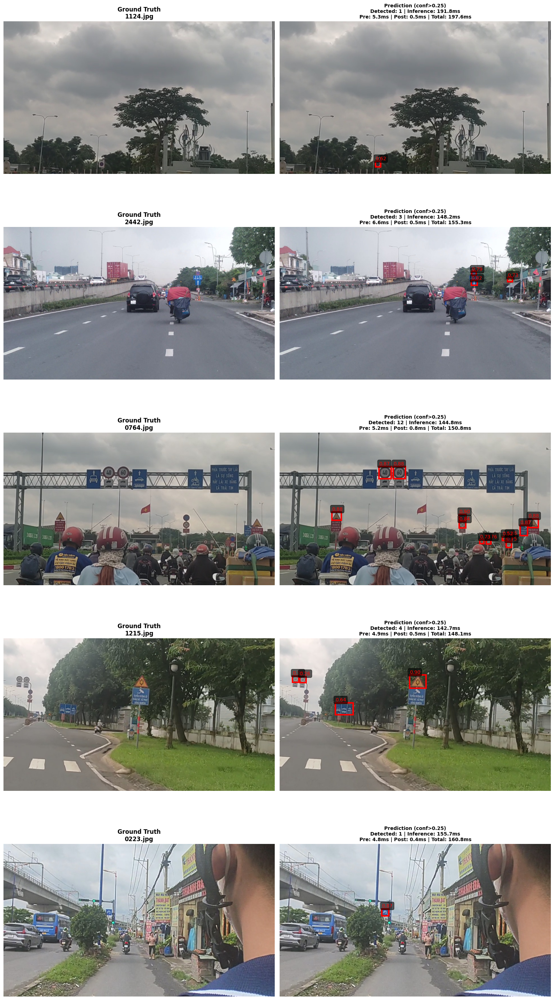


⏱️  Inference Timing Statistics (5 images):
   Average: 156.63ms (±18.14ms)
   Min: 142.67ms | Max: 191.82ms
   FPS: 6.4
✅ Saved visualization to: viz/yolo5_visualization.png


'viz/yolo5_visualization.png'

In [14]:
onnx_model = "./convert/model/yolo5/yolo5.onnx"
data_yaml = "./Dataset/Detect/data_detect_vntsr/data.yaml"

visualize_predictions_yolo(onnx_model, data_yaml, num_samples=5)

### YOLOv8n

In [15]:
pt_path = "./weight/yolo8.pt"
work_dir = "convert/model/yolo8"
onnx_path = os.path.join(work_dir, "yolo8.onnx")

os.makedirs(work_dir, exist_ok=True)

pt_copy_path = os.path.join(work_dir, "yolo8.pt")
shutil.copy(pt_path, pt_copy_path)

model = YOLO(pt_copy_path, task='detect')

model.export(format="onnx", opset=12, imgsz=640, simplify=True)

for f in os.listdir(work_dir):
    if f.endswith(".onnx"):
        export_file = os.path.join(work_dir, f)
        os.rename(export_file, onnx_path)
        break

os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from 'convert/model/yolo8/yolo8.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (6.0 MB)

ONNX: starting export with onnx 1.19.1 opset 12...
ONNX: slimming with onnxslim 0.1.74...
ONNX: export success ✅ 3.8s, saved as 'convert/model/yolo8/yolo8.onnx' (11.7 MB)

Export complete (4.9s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo8
Predict:         yolo predict task=detect model=convert/model/yolo8/yolo8.onnx imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo8/yolo8.onnx imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from yolo8.onnx
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
⏳ Loading ONNX model with ONNX Runtime...
✅ Loaded ONNX model successfully
   Input name: images
   Input shape: [1, 3, 640, 640]
   Output shape: [1, 5, 8400]

⏱️  Processing images...


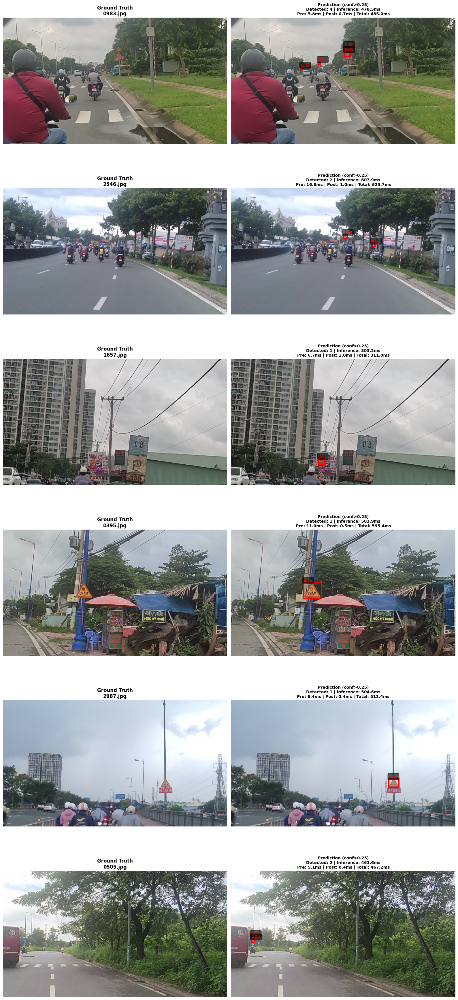


⏱️  Inference Timing Statistics (6 images):
   Average: 489.96ms (±98.97ms)
   Min: 303.23ms | Max: 607.94ms
   FPS: 2.0
✅ Saved visualization to: viz/yolo8_visualization.png


'viz/yolo8_visualization.png'

In [16]:
onnx_model = "./convert/model/yolo8/yolo8.onnx"

visualize_predictions_yolo(
    onnx_path=onnx_model,
    data_yaml= data_yaml,
    num_samples=6,
    conf_threshold=0.25,
)

### YOLOv11n

In [10]:
pt_path = "./weight/yolo11.pt"
work_dir = "convert/model/yolo11"
onnx_path = os.path.join(work_dir, "yolo11.onnx")

# --- Tạo thư mục đích ---
os.makedirs(work_dir, exist_ok=True)

# --- Copy model .pt ra thư mục working ---
pt_copy_path = os.path.join(work_dir, "yolo11.pt")
shutil.copy(pt_path, pt_copy_path)

# --- Tải model YOLO11 ---
yolo11 = YOLO(pt_copy_path)

# --- Export sang ONNX ---
yolo11.export(format="onnx", imgsz=640, dynamic=True)

# --- Tìm file ONNX được tạo ra ---
for f in os.listdir(work_dir):
    if f.endswith(".onnx"):
        export_file = os.path.join(work_dir, f)
        os.rename(export_file, onnx_path)
        break

# --- Xóa file .pt ---
os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs

PyTorch: starting from 'convert/model/yolo11/yolo11.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.2 MB)

ONNX: starting export with onnx 1.19.1 opset 22...
ONNX: slimming with onnxslim 0.1.74...
ONNX: export success ✅ 4.1s, saved as 'convert/model/yolo11/yolo11.onnx' (10.6 MB)

Export complete (5.3s)
Results saved to /home/pi5/TrafficSign/TT100K/convert/model/yolo11
Predict:         yolo predict task=detect model=convert/model/yolo11/yolo11.onnx imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo11/yolo11.onnx imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from yolo11.onnx
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
⏳ Loading ONNX model with ONNX Runtime...
✅ Loaded ONNX model successfully
   Input name: images
   Input shape: ['batch', 3, 'height', 'width']
   Output shape: ['batch', 5, 'anchors']

⏱️  Processing images...


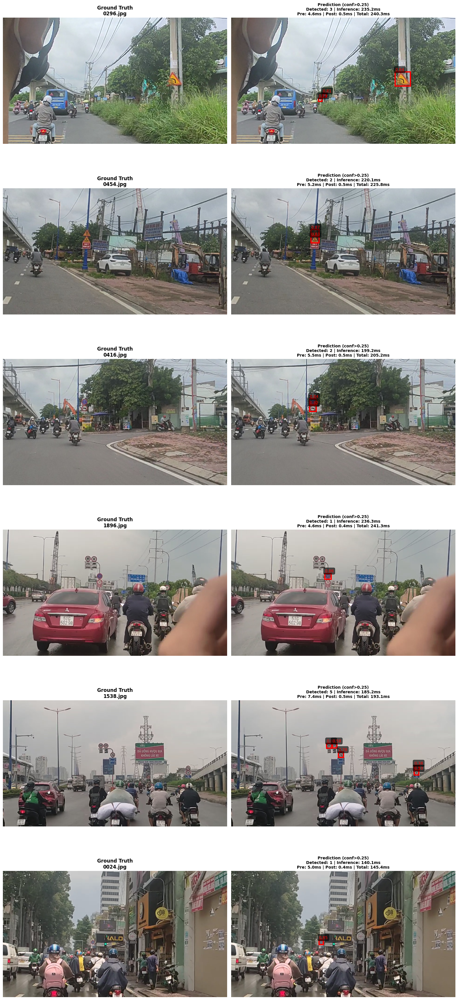


⏱️  Inference Timing Statistics (6 images):
   Average: 202.67ms (±33.49ms)
   Min: 140.07ms | Max: 236.29ms
   FPS: 4.9
✅ Saved visualization to: viz/yolo11_visualization.png


'viz/yolo11_visualization.png'

In [17]:
onnx_model = "./convert/model/yolo11/yolo11.onnx"
visualize_predictions_yolo(
    onnx_path=onnx_model,
    data_yaml= data_yaml,
    num_samples=6,
    conf_threshold=0.25,
)

### YOLO_custom

In [18]:
pt_path = "./weight/yolo_plus/yolo_plus_v2.pt"
work_dir = "convert/model/yolo_plus"
onnx_path = os.path.join(work_dir, "yolo_plus.onnx")

os.makedirs(work_dir, exist_ok=True)

pt_copy_path = os.path.join(work_dir, "yolo_plus.pt")
shutil.copy(pt_path, pt_copy_path)

model = YOLO(pt_copy_path, task='detect')

model.export(format="onnx", opset=12, imgsz=640, simplify=True)

for f in os.listdir(work_dir):
    if f.endswith(".onnx"):
        export_file = os.path.join(work_dir, f)
        os.rename(export_file, onnx_path)
        break

os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
YOLO_plus_v1 summary (fused): 72 layers, 966,355 parameters, 0 gradients, 2.8 GFLOPs

PyTorch: starting from 'convert/model/yolo_plus/yolo_plus.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (2.1 MB)

ONNX: starting export with onnx 1.19.1 opset 12...
ONNX: slimming with onnxslim 0.1.74...
ONNX: export success ✅ 1.4s, saved as 'convert/model/yolo_plus/yolo_plus.onnx' (3.9 MB)

Export complete (2.0s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo_plus
Predict:         yolo predict task=detect model=convert/model/yolo_plus/yolo_plus.onnx imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo_plus/yolo_plus.onnx imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from yolo_plus.onnx
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
⏳ Loading ONNX model with ONNX Runtime...
✅ Loaded ONNX model successfully
   Input name: images
   Input shape: [1, 3, 640, 640]
   Output shape: [1, 5, 8400]

⏱️  Processing images...


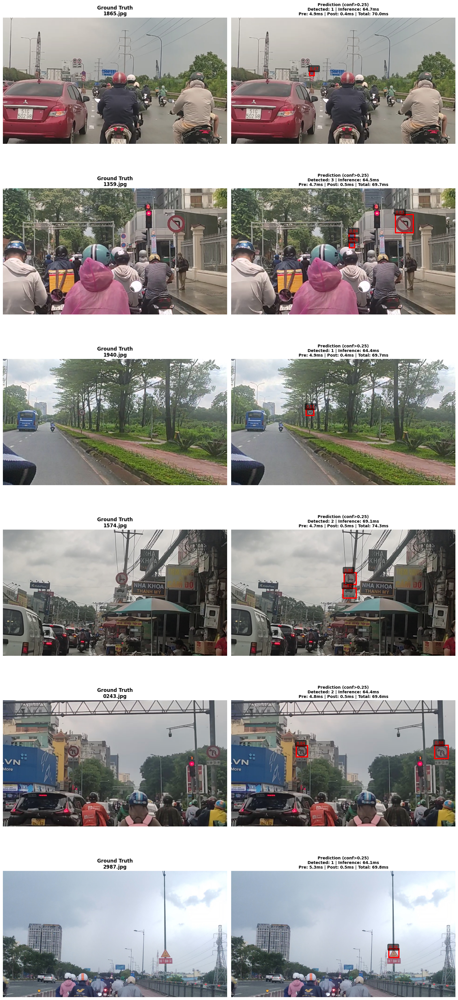


⏱️  Inference Timing Statistics (6 images):
   Average: 65.20ms (±1.76ms)
   Min: 64.08ms | Max: 69.12ms
   FPS: 15.3
✅ Saved visualization to: viz/yolo_plus_visualization.png


'viz/yolo_plus_visualization.png'

In [20]:
onnx_model = "./convert/model/yolo_plus/yolo_plus.onnx"
visualize_predictions_yolo(
    onnx_path=onnx_model,
    data_yaml= data_yaml,
    num_samples=6,
    conf_threshold=0.25,
)

### ssd300

### faster_rcnn

## OpenVINO

In [5]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import yaml
import random
from pathlib import Path
from openvino.runtime import Core
import time


def letterbox(img, new_shape=(640, 640), color=(114, 114, 114)):
    """
    Resize and pad image to new_shape với letterbox
    """
    shape = img.shape[:2]  # current shape [height, width]
    if isinstance(new_shape, int):
        new_shape = (new_shape, new_shape)
    
    # Scale ratio (new / old)
    r = min(new_shape[0] / shape[0], new_shape[1] / shape[1])
    
    # Compute padding
    new_unpad = int(round(shape[1] * r)), int(round(shape[0] * r))
    dw, dh = new_shape[1] - new_unpad[0], new_shape[0] - new_unpad[1]  # wh padding
    
    dw /= 2  # divide padding into 2 sides
    dh /= 2
    
    if shape[::-1] != new_unpad:  # resize
        img = cv2.resize(img, new_unpad, interpolation=cv2.INTER_LINEAR)
    
    top, bottom = int(round(dh - 0.1)), int(round(dh + 0.1))
    left, right = int(round(dw - 0.1)), int(round(dw + 0.1))
    img = cv2.copyMakeBorder(img, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)
    
    return img, r, (dw, dh)


def preprocess_image(img, input_size=(640, 640)):
    """
    Preprocess image cho OpenVINO model
    img: BGR image từ cv2.imread
    input_size: (height, width) của model input
    """
    # Letterbox resize
    img_resized, ratio, (dw, dh) = letterbox(img, new_shape=input_size)
    
    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)
    
    # Normalize to [0, 1]
    img_normalized = img_rgb.astype(np.float32) / 255.0
    
    # HWC to CHW
    img_transposed = img_normalized.transpose(2, 0, 1)
    
    # Add batch dimension
    img_batch = np.expand_dims(img_transposed, axis=0)
    
    return img_batch, ratio, (dw, dh)


def postprocess_output(output, orig_shape, ratio, pad, conf_threshold=0.25):
    """
    Postprocess OpenVINO output về bounding boxes
    output: numpy array từ OpenVINO model (1, 84, 8400) hoặc (1, 8400, 84)
    orig_shape: (height, width) của ảnh gốc
    ratio: scale ratio từ letterbox
    pad: (dw, dh) padding từ letterbox
    """
    # Kiểm tra shape và transpose nếu cần
    if output.shape[-1] == 84:
        output = output.transpose(0, 2, 1)  # (1, 8400, 84) -> (1, 84, 8400)
    
    # Lấy predictions
    predictions = output[0]  # (84, 8400)
    
    # predictions[0:4] = box coordinates (x_center, y_center, width, height)
    # predictions[4:] = class scores
    boxes = predictions[:4].T  # (8400, 4)
    scores = predictions[4:].T  # (8400, 80) hoặc số classes
    
    # Lấy max score và class cho mỗi box
    class_scores = np.max(scores, axis=1)  # (8400,)
    class_ids = np.argmax(scores, axis=1)  # (8400,)
    
    # Filter theo confidence threshold
    mask = class_scores > conf_threshold
    boxes = boxes[mask]
    scores = class_scores[mask]
    class_ids = class_ids[mask]
    
    if len(boxes) == 0:
        return np.empty((0, 4)), np.empty((0,)), np.empty((0,))
    
    # Convert từ xywh to xyxy
    x_center, y_center, width, height = boxes[:, 0], boxes[:, 1], boxes[:, 2], boxes[:, 3]
    x1 = x_center - width / 2
    y1 = y_center - height / 2
    x2 = x_center + width / 2
    y2 = y_center + height / 2
    
    boxes_xyxy = np.stack([x1, y1, x2, y2], axis=1)
    
    # Scale boxes về kích thước ảnh gốc (remove letterbox padding)
    boxes_xyxy[:, [0, 2]] -= pad[0]  # x padding
    boxes_xyxy[:, [1, 3]] -= pad[1]  # y padding
    boxes_xyxy /= ratio
    
    # Clip boxes về image boundaries
    boxes_xyxy[:, [0, 2]] = np.clip(boxes_xyxy[:, [0, 2]], 0, orig_shape[1])
    boxes_xyxy[:, [1, 3]] = np.clip(boxes_xyxy[:, [1, 3]], 0, orig_shape[0])
    
    return boxes_xyxy, scores, class_ids


def visualize_predictions_openvino(
    model_path,
    data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    save_dir="viz",
    input_size=(640, 640),  # Model input size (height, width)
    device="CPU",  # CPU, GPU, or AUTO
):
    """
    Visualize predictions (YOLO với OpenVINO) vs ground truth
    
    Args:
        model_path: Path to .xml model file hoặc .onnx file
        data_yaml: Path to data.yaml
        num_samples: Số lượng ảnh để visualize
        conf_threshold: Confidence threshold
        save_dir: Thư mục lưu kết quả
        input_size: (height, width) của model input
        device: Device để run inference (CPU, GPU, AUTO)
    """
    os.makedirs(save_dir, exist_ok=True)
    print(f"\n🎨 Visualizing {num_samples} images from {os.path.basename(model_path)}")
    print(f"📊 Confidence threshold: {conf_threshold}")
    print(f"📐 Model input size: {input_size}")
    print(f"🖥️  Device: {device}")
    
    # --- Load OpenVINO model ---
    print(f"⏳ Loading model with OpenVINO...")
    ie = Core()
    
    # Load model (hỗ trợ cả .xml và .onnx)
    model = ie.read_model(model=model_path)
    compiled_model = ie.compile_model(model=model, device_name=device)
    
    # Get input/output info
    input_layer = compiled_model.input(0)
    output_layer = compiled_model.output(0)
    
    print(f"✅ Loaded OpenVINO model successfully")
    print(f"   Input shape: {input_layer.shape}")
    print(f"   Output shape: {output_layer.shape}")
    print(f"   Input type: {input_layer.element_type}")
    
    # --- Load dataset config ---
    with open(data_yaml, 'r') as f:
        data_config = yaml.safe_load(f)
    
    dataset_root = Path(data_yaml).parent
    test_images_path = dataset_root / data_config.get('val', 'test/images')
    test_labels_path = dataset_root / data_config.get('val', 'test/labels')
    
    # --- Sample random images ---
    image_files = list(test_images_path.glob('*.jpg')) + list(test_images_path.glob('*.png'))
    sample_images = random.sample(image_files, min(num_samples, len(image_files)))
    
    # --- Create figure ---
    fig, axes = plt.subplots(len(sample_images), 2, figsize=(16, 6 * len(sample_images)))
    if len(sample_images) == 1:
        axes = axes.reshape(1, -1)
    
    # Track inference times
    inference_times = []
    print(f"\n⏱️  Processing images...")
    
    for idx, img_path in enumerate(sample_images):
        img = cv2.imread(str(img_path))
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        orig_h, orig_w = img.shape[:2]
        
        # === Load Ground Truth ===
        label_path = test_labels_path / (img_path.stem + '.txt')
        gt_boxes = []
        if label_path.exists():
            with open(label_path, 'r') as f:
                for line in f:
                    cls, xc, yc, w, h = map(float, line.strip().split()[:5])
                    gt_boxes.append((xc, yc, w, h))
        
        # === Run OpenVINO inference ===
        # Preprocess
        start_preprocess = time.time()
        input_tensor, ratio, pad = preprocess_image(img, input_size=input_size)
        preprocess_time = time.time() - start_preprocess
        
        # Inference
        start_inference = time.time()
        outputs = compiled_model([input_tensor])[output_layer]
        inference_time = time.time() - start_inference
        inference_times.append(inference_time)
        
        # Postprocess
        start_postprocess = time.time()
        boxes_xyxy, scores, class_ids = postprocess_output(
            outputs, 
            (orig_h, orig_w), 
            ratio, 
            pad, 
            conf_threshold
        )
        postprocess_time = time.time() - start_postprocess
        
        total_time = preprocess_time + inference_time + postprocess_time
        
        # === Visualization ===
        ax1, ax2 = axes[idx]
        
        # Ground Truth
        ax1.imshow(img_rgb)
        ax1.set_title(f'Ground Truth\n{img_path.name}', fontsize=12, fontweight='bold')
        ax1.axis('off')
        
        for (xc, yc, w, h) in gt_boxes:
            x1 = int((xc - w / 2) * orig_w)
            y1 = int((yc - h / 2) * orig_h)
            x2 = int((xc + w / 2) * orig_w)
            y2 = int((yc + h / 2) * orig_h)
            ax1.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                        fill=False, edgecolor='lime', linewidth=3))
            ax1.text(x1, y1 - 5, 'GT', color='lime', fontsize=10,
                     bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.6))
        
        # Predictions
        ax2.imshow(img_rgb)
        timing_info = (f'Prediction (conf>{conf_threshold})\n'
                      f'Detected: {len(boxes_xyxy)} | '
                      f'Inference: {inference_time*1000:.1f}ms\n'
                      f'Pre: {preprocess_time*1000:.1f}ms | '
                      f'Post: {postprocess_time*1000:.1f}ms | '
                      f'Total: {total_time*1000:.1f}ms')
        ax2.set_title(timing_info, fontsize=10, fontweight='bold')
        ax2.axis('off')
        
        for box, score in zip(boxes_xyxy, scores):
            x1, y1, x2, y2 = map(int, box)
            ax2.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                        fill=False, edgecolor='red', linewidth=3))
            ax2.text(x1, y1 - 5, f'{score:.2f}', color='red', fontsize=10,
                     bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.6))
    
    plt.tight_layout()
    save_path = os.path.join(save_dir, f"{Path(onnx_path).stem}_visualization.png")
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    plt.show()
    
    # Print timing statistics
    avg_inference = np.mean(inference_times) * 1000
    std_inference = np.std(inference_times) * 1000
    min_inference = np.min(inference_times) * 1000
    max_inference = np.max(inference_times) * 1000
    fps = 1 / np.mean(inference_times)
    
    print(f"\n⏱️  Inference Timing Statistics ({len(inference_times)} images):")
    print(f"   Average: {avg_inference:.2f}ms (±{std_inference:.2f}ms)")
    print(f"   Min: {min_inference:.2f}ms | Max: {max_inference:.2f}ms")
    print(f"   FPS: {fps:.1f}")
    print(f"✅ Saved visualization to: {save_path}")
    
    return save_path


/home/pi5/TrafficSign/venv_tsr/lib/python3.13/site-packages/openvino/runtime/__init__.py:10: DeprecationWarning: The `openvino.runtime` module is deprecated and will be removed in the 2026.0 release. Please replace `openvino.runtime` with `openvino`.
  warnings.warn(


### YOLO5

In [22]:
pt_path = "./weight/yolo5.pt"
work_dir = "convert/model/yolo5"

pt_copy_path = os.path.join(work_dir, "yolo5.pt")
shutil.copy(pt_path, pt_copy_path)

yolo5 = YOLO(pt_copy_path)

yolo5.export(format="openvino", imgsz=640)

export_files = [os.path.join(work_dir, f) for f in os.listdir(work_dir) if f.endswith(".xml") or f.endswith(".bin")]

os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
YOLOv5n summary (fused): 84 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs



PyTorch: starting from 'convert/model/yolo5/yolo5.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.0 MB)

OpenVINO: starting export with openvino 2025.3.0-19807-44526285f24-releases/2025/3...
OpenVINO: export success ✅ 8.9s, saved as 'convert/model/yolo5/yolo5_openvino_model/' (9.9 MB)

Export complete (9.8s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo5
Predict:         yolo predict task=detect model=convert/model/yolo5/yolo5_openvino_model imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo5/yolo5_openvino_model imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from yolo5.xml
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
🖥️  Device: CPU
⏳ Loading model with OpenVINO...
✅ Loaded OpenVINO model successfully
   Input shape: [1,3,640,640]
   Output shape: [1,5,8400]
   Input type: <Type: 'float32'>

⏱️  Processing images...


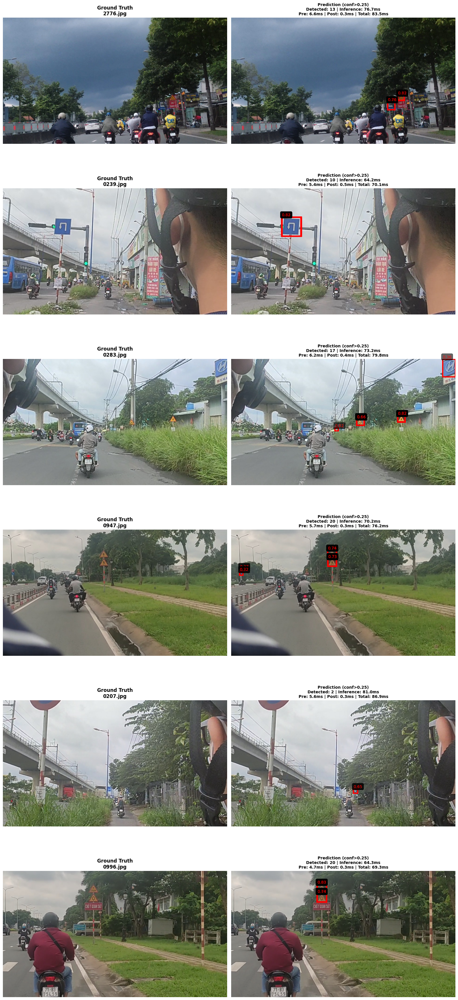


⏱️  Inference Timing Statistics (6 images):
   Average: 71.61ms (±6.14ms)
   Min: 64.24ms | Max: 81.03ms
   FPS: 14.0
✅ Saved visualization to: viz/yolo_plus_visualization.png


'viz/yolo_plus_visualization.png'

In [23]:
visualize_predictions_openvino(
    model_path="./convert/model/yolo5/yolo5_openvino_model/yolo5.xml",  # hoặc model.onnx
    data_yaml=data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    input_size=(640, 640),
    device="CPU"  # hoặc "GPU", "AUTO"
)

### YOLO8

In [24]:
# --- Đường dẫn ---
pt_path = "./weight/yolo8.pt"
work_dir = "convert/model/yolo8"
os.makedirs(work_dir, exist_ok=True)

pt_copy_path = os.path.join(work_dir, "yolo8.pt")
shutil.copy(pt_path, pt_copy_path)

yolo5 = YOLO(pt_copy_path)

yolo5.export(format="openvino", imgsz=640)

export_files = [os.path.join(work_dir, f) for f in os.listdir(work_dir) if f.endswith(".xml") or f.endswith(".bin")]

os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from 'convert/model/yolo8/yolo8.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (6.0 MB)

OpenVINO: starting export with openvino 2025.3.0-19807-44526285f24-releases/2025/3...
OpenVINO: export success ✅ 4.7s, saved as 'convert/model/yolo8/yolo8_openvino_model/' (11.8 MB)

Export complete (6.2s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo8
Predict:         yolo predict task=detect model=convert/model/yolo8/yolo8_openvino_model imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo8/yolo8_openvino_model imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from yolo8.xml
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
🖥️  Device: CPU
⏳ Loading model with OpenVINO...
✅ Loaded OpenVINO model successfully
   Input shape: [1,3,640,640]
   Output shape: [1,5,8400]
   Input type: <Type: 'float32'>

⏱️  Processing images...


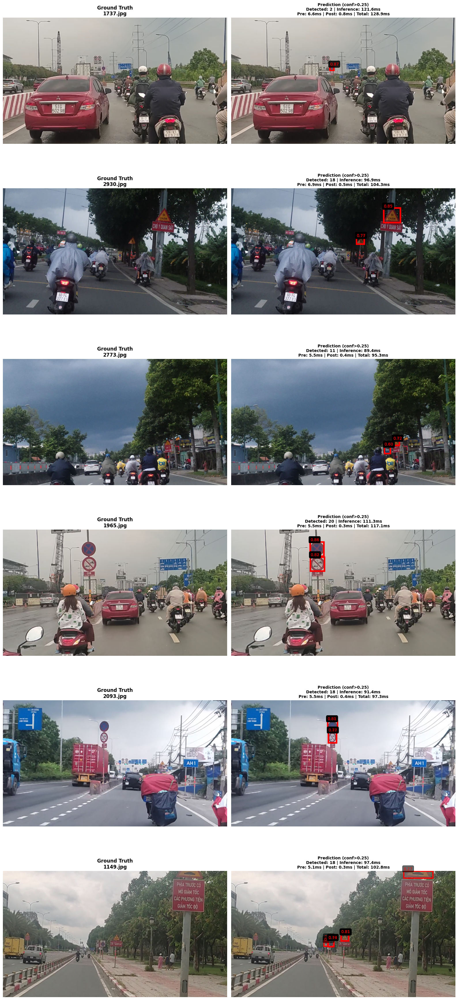


⏱️  Inference Timing Statistics (6 images):
   Average: 101.32ms (±11.44ms)
   Min: 89.37ms | Max: 121.57ms
   FPS: 9.9
✅ Saved visualization to: viz/yolo_plus_visualization.png


'viz/yolo_plus_visualization.png'

In [25]:
visualize_predictions_openvino(
    model_path="./convert/model/yolo8/yolo8_openvino_model/yolo8.xml",  # hoặc model.onnx
    data_yaml=data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    input_size=(640, 640),
    device="CPU"  # hoặc "GPU", "AUTO"
)

### YOLO11

In [26]:
# --- Đường dẫn ---
pt_path = "./weight/yolo11.pt"
work_dir = "convert/model/yolo11"
os.makedirs(work_dir, exist_ok=True)

pt_copy_path = os.path.join(work_dir, "yolo11.pt")
shutil.copy(pt_path, pt_copy_path)

yolo5 = YOLO(pt_copy_path)

yolo5.export(format="openvino", imgsz=640)

export_files = [os.path.join(work_dir, f) for f in os.listdir(work_dir) if f.endswith(".xml") or f.endswith(".bin")]

os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs

PyTorch: starting from 'convert/model/yolo11/yolo11.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.2 MB)

OpenVINO: starting export with openvino 2025.3.0-19807-44526285f24-releases/2025/3...
OpenVINO: export success ✅ 9.9s, saved as 'convert/model/yolo11/yolo11_openvino_model/' (10.2 MB)

Export complete (11.1s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo11
Predict:         yolo predict task=detect model=convert/model/yolo11/yolo11_openvino_model imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo11/yolo11_openvino_model imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from yolo11.xml
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
🖥️  Device: CPU
⏳ Loading model with OpenVINO...
✅ Loaded OpenVINO model successfully
   Input shape: [1,3,640,640]
   Output shape: [1,5,8400]
   Input type: <Type: 'float32'>

⏱️  Processing images...


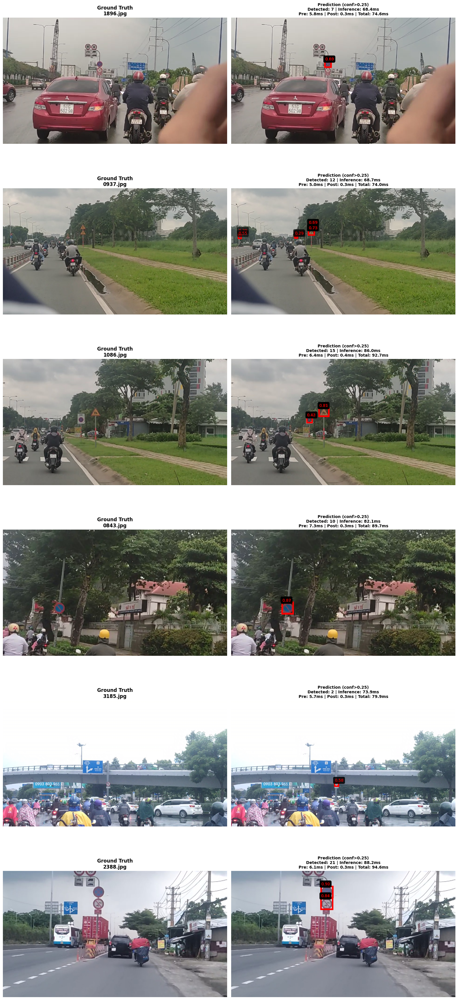


⏱️  Inference Timing Statistics (6 images):
   Average: 77.89ms (±7.96ms)
   Min: 68.44ms | Max: 88.22ms
   FPS: 12.8
✅ Saved visualization to: viz/yolo_plus_visualization.png


'viz/yolo_plus_visualization.png'

In [27]:
visualize_predictions_openvino(
    model_path="./convert/model/yolo11/yolo11_openvino_model/yolo11.xml",  # hoặc model.onnx
    data_yaml=data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    input_size=(640, 640),
    device="CPU"  # hoặc "GPU", "AUTO"
)

### YOLO_Plus

In [28]:
# --- Đường dẫn ---
pt_path = "./weight/yolo_plus/yolo_plus_v2.pt"
work_dir = "./convert/model/yolo_plus"
os.makedirs(work_dir, exist_ok=True)

pt_copy_path = os.path.join(work_dir, "yolo_plus.pt")
shutil.copy(pt_path, pt_copy_path)

yolo = YOLO(pt_copy_path)

yolo.export(format="openvino", imgsz=640)

export_files = [os.path.join(work_dir, f) for f in os.listdir(work_dir) if f.endswith(".xml") or f.endswith(".bin")]

os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
YOLO_plus_v1 summary (fused): 72 layers, 966,355 parameters, 0 gradients, 2.8 GFLOPs

PyTorch: starting from 'convert/model/yolo_plus/yolo_plus.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (2.1 MB)

OpenVINO: starting export with openvino 2025.3.0-19807-44526285f24-releases/2025/3...
OpenVINO: export success ✅ 3.5s, saved as 'convert/model/yolo_plus/yolo_plus_openvino_model/' (4.0 MB)

Export complete (4.0s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo_plus
Predict:         yolo predict task=detect model=convert/model/yolo_plus/yolo_plus_openvino_model imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo_plus/yolo_plus_openvino_model imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from yolo_plus.xml
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
🖥️  Device: CPU
⏳ Loading model with OpenVINO...
✅ Loaded OpenVINO model successfully
   Input shape: [1,3,640,640]
   Output shape: [1,5,8400]
   Input type: <Type: 'float32'>

⏱️  Processing images...


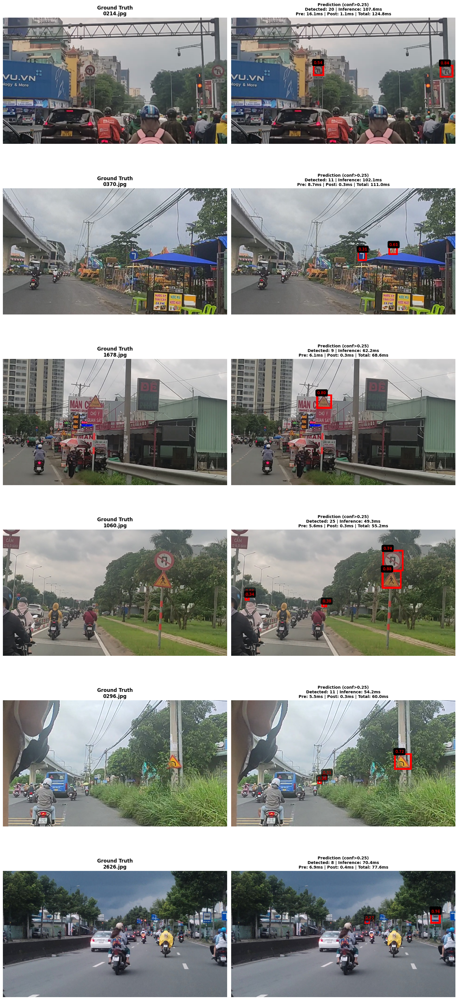


⏱️  Inference Timing Statistics (6 images):
   Average: 74.30ms (±22.62ms)
   Min: 49.31ms | Max: 107.63ms
   FPS: 13.5
✅ Saved visualization to: viz/yolo_plus_visualization.png


'viz/yolo_plus_visualization.png'

In [29]:
visualize_predictions_openvino(
    model_path="./convert/model/yolo_plus/yolo_plus_openvino_model/yolo_plus.xml",  # hoặc model.onnx
    data_yaml=data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    input_size=(640, 640),
    device="CPU"  # hoặc "GPU", "AUTO"
)

## NCNN

In [30]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import yaml
import random
from pathlib import Path
import ncnn
import time

In [31]:

def letterbox(img, new_shape=(640, 640), color=(114, 114, 114)):
    """
    Resize and pad image to new_shape với letterbox
    """
    shape = img.shape[:2]  # current shape [height, width]
    if isinstance(new_shape, int):
        new_shape = (new_shape, new_shape)
    
    # Scale ratio (new / old)
    r = min(new_shape[0] / shape[0], new_shape[1] / shape[1])
    
    # Compute padding
    new_unpad = int(round(shape[1] * r)), int(round(shape[0] * r))
    dw, dh = new_shape[1] - new_unpad[0], new_shape[0] - new_unpad[1]  # wh padding
    
    dw /= 2  # divide padding into 2 sides
    dh /= 2
    
    if shape[::-1] != new_unpad:  # resize
        img = cv2.resize(img, new_unpad, interpolation=cv2.INTER_LINEAR)
    
    top, bottom = int(round(dh - 0.1)), int(round(dh + 0.1))
    left, right = int(round(dw - 0.1)), int(round(dw + 0.1))
    img = cv2.copyMakeBorder(img, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)
    
    return img, r, (dw, dh)

def nms_numpy(boxes, scores, iou_threshold=0.45):
    if len(boxes) == 0:
        return []
    x1, y1, x2, y2 = boxes.T
    areas = (x2 - x1) * (y2 - y1)
    order = scores.argsort()[::-1]
    keep = []

    while order.size > 0:
        i = order[0]
        keep.append(i)
        # Tính IoU
        xx1 = np.maximum(x1[i], x1[order[1:]])
        yy1 = np.maximum(y1[i], y1[order[1:]])
        xx2 = np.minimum(x2[i], x2[order[1:]])
        yy2 = np.minimum(y2[i], y2[order[1:]])

        w = np.maximum(0.0, xx2 - xx1)
        h = np.maximum(0.0, yy2 - yy1)
        inter = w * h
        iou = inter / (areas[i] + areas[order[1:]] - inter)

        inds = np.where(iou <= iou_threshold)[0]
        order = order[inds + 1]

    return keep

def preprocess_image_ncnn(img, input_size=(640, 640)):
    """
    Preprocess image cho NCNN model
    img: BGR image từ cv2.imread
    input_size: (height, width) của model input
    Returns: ncnn.Mat object, ratio, pad
    """
    # Letterbox resize
    img_resized, ratio, (dw, dh) = letterbox(img, new_shape=input_size)
    
    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)
    
    # NCNN expects RGB format, normalize to [0, 1] và subtract mean/divide by std
    # Mean: [0, 0, 0], Std: [255, 255, 255] để normalize về [0, 1]
    mat_in = ncnn.Mat.from_pixels(
        img_rgb,
        ncnn.Mat.PixelType.PIXEL_RGB,
        img_rgb.shape[1],  # width
        img_rgb.shape[0]   # height
    )
    
    # Normalize
    mean_vals = [0, 0, 0]
    norm_vals = [1/255.0, 1/255.0, 1/255.0]
    mat_in.substract_mean_normalize(mean_vals, norm_vals)
    
    return mat_in, ratio, (dw, dh)


def postprocess_output(output, orig_shape, ratio, pad, conf_threshold=0.25):
    """
    Postprocess NCNN output về bounding boxes
    output: numpy array từ NCNN model (1, 84, 8400) hoặc (84, 8400) hoặc (1, 8400, 84)
    orig_shape: (height, width) của ảnh gốc
    ratio: scale ratio từ letterbox
    pad: (dw, dh) padding từ letterbox
    """
    # Convert ncnn.Mat to numpy nếu cần
    if isinstance(output, ncnn.Mat):
        output = np.array(output)
    
    # Chuẩn hóa shape về (1, 84, 8400)
    if output.ndim == 2:  # (84, 8400)
        output = np.expand_dims(output, axis=0)
    elif output.shape[-1] == 84:  # (1, 8400, 84)
        output = output.transpose(0, 2, 1)
    
    # Lấy predictions
    predictions = output[0]  # (84, 8400)
    
    # predictions[0:4] = box coordinates (x_center, y_center, width, height)
    # predictions[4:] = class scores
    boxes = predictions[:4].T  # (8400, 4)
    scores = predictions[4:].T  # (8400, 80) hoặc số classes
    
    # Lấy max score và class cho mỗi box
    class_scores = np.max(scores, axis=1)  # (8400,)
    class_ids = np.argmax(scores, axis=1)  # (8400,)
    
    # Filter theo confidence threshold
    mask = class_scores > conf_threshold
    boxes = boxes[mask]
    scores = class_scores[mask]
    class_ids = class_ids[mask]
    
    if len(boxes) == 0:
        return np.empty((0, 4)), np.empty((0,)), np.empty((0,))
    
    # Convert từ xywh to xyxy
    x_center, y_center, width, height = boxes[:, 0], boxes[:, 1], boxes[:, 2], boxes[:, 3]
    x1 = x_center - width / 2
    y1 = y_center - height / 2
    x2 = x_center + width / 2
    y2 = y_center + height / 2
    
    boxes_xyxy = np.stack([x1, y1, x2, y2], axis=1)
    
    # Scale boxes về kích thước ảnh gốc (remove letterbox padding)
    boxes_xyxy[:, [0, 2]] -= pad[0]  # x padding
    boxes_xyxy[:, [1, 3]] -= pad[1]  # y padding
    boxes_xyxy /= ratio
    
    # Clip boxes về image boundaries
    boxes_xyxy[:, [0, 2]] = np.clip(boxes_xyxy[:, [0, 2]], 0, orig_shape[1])
    boxes_xyxy[:, [1, 3]] = np.clip(boxes_xyxy[:, [1, 3]], 0, orig_shape[0])
    # Apply NMS
    nms_indices = []
    for cls in np.unique(class_ids):
        cls_mask = class_ids == cls
        keep = nms_numpy(boxes_xyxy[cls_mask], scores[cls_mask], iou_threshold=0.45)
        nms_indices.extend(np.where(cls_mask)[0][keep])
    
    nms_indices = np.array(nms_indices)
    boxes_xyxy = boxes_xyxy[nms_indices]
    scores = scores[nms_indices]
    class_ids = class_ids[nms_indices]

    return boxes_xyxy, scores, class_ids


def visualize_predictions_ncnn(
    param_path,
    bin_path,
    data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    save_dir="viz",
    input_size=(640, 640),  # Model input size (height, width)
    input_name="images",    # Input blob name
    output_name="output0",  # Output blob name
    use_gpu=False,          # Use GPU (Vulkan)
    num_threads=4,          # Number of threads
):
    """
    Visualize predictions (YOLO với NCNN) vs ground truth
    
    Args:
        param_path: Path to .param file (model structure)
        bin_path: Path to .bin file (model weights)
        data_yaml: Path to data.yaml
        num_samples: Số lượng ảnh để visualize
        conf_threshold: Confidence threshold
        save_dir: Thư mục lưu kết quả
        input_size: (height, width) của model input
        input_name: Tên của input blob (thường là "images" hoặc "in0")
        output_name: Tên của output blob (thường là "output0" hoặc "out0")
        use_gpu: Sử dụng GPU (Vulkan) hay không
        num_threads: Số threads cho CPU inference
    """
    os.makedirs(save_dir, exist_ok=True)
    print(f"\n🎨 Visualizing {num_samples} images from {os.path.basename(param_path)}")
    print(f"📊 Confidence threshold: {conf_threshold}")
    print(f"📐 Model input size: {input_size}")
    print(f"🖥️  Device: {'GPU (Vulkan)' if use_gpu else f'CPU ({num_threads} threads)'}")
    
    # --- Load NCNN model ---
    print(f"⏳ Loading model with NCNN...")
    net = ncnn.Net()
    
    # Configure NCNN
    net.opt.use_vulkan_compute = use_gpu
    net.opt.num_threads = num_threads
    
    # Load model
    ret = net.load_param(param_path)
    if ret != 0:
        raise RuntimeError(f"Failed to load param file: {param_path}")
    
    ret = net.load_model(bin_path)
    if ret != 0:
        raise RuntimeError(f"Failed to load bin file: {bin_path}")
    
    print(f"✅ Loaded NCNN model successfully")
    print(f"   Param: {param_path}")
    print(f"   Bin: {bin_path}")
    print(f"   Input blob: {input_name}")
    print(f"   Output blob: {output_name}")
    
    # --- Load dataset config ---
    with open(data_yaml, 'r') as f:
        data_config = yaml.safe_load(f)
    
    dataset_root = Path(data_yaml).parent
    test_images_path = dataset_root / data_config.get('val', 'test/images')
    test_labels_path = dataset_root / data_config.get('val', 'test/labels')
    
    # --- Sample random images ---
    image_files = list(test_images_path.glob('*.jpg')) + list(test_images_path.glob('*.png'))
    sample_images = random.sample(image_files, min(num_samples, len(image_files)))
    
    # --- Create figure ---
    fig, axes = plt.subplots(len(sample_images), 2, figsize=(16, 6 * len(sample_images)))
    if len(sample_images) == 1:
        axes = axes.reshape(1, -1)
    
    # Track inference times
    inference_times = []
    print(f"\n⏱️  Processing images...")
    
    for idx, img_path in enumerate(sample_images):
        img = cv2.imread(str(img_path))
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        orig_h, orig_w = img.shape[:2]
        
        # === Load Ground Truth ===
        label_path = test_labels_path / (img_path.stem + '.txt')
        gt_boxes = []
        if label_path.exists():
            with open(label_path, 'r') as f:
                for line in f:
                    cls, xc, yc, w, h = map(float, line.strip().split()[:5])
                    gt_boxes.append((xc, yc, w, h))
        
        # === Run NCNN inference ===
        # Preprocess
        start_preprocess = time.time()
        mat_in, ratio, pad = preprocess_image_ncnn(img, input_size=input_size)
        preprocess_time = time.time() - start_preprocess
        
        # Inference
        start_inference = time.time()
        ex = net.create_extractor()
        ex.input(input_name, mat_in)
        ret, mat_out = ex.extract(output_name)
        inference_time = time.time() - start_inference
        inference_times.append(inference_time)
        
        if ret != 0:
            print(f"   ⚠️  Failed to extract output for {img_path.name}")
            continue
        
        # Postprocess
        start_postprocess = time.time()
        # Convert ncnn.Mat to numpy
        output_array = np.array(mat_out)
        boxes_xyxy, scores, class_ids = postprocess_output(
            output_array,
            (orig_h, orig_w),
            ratio,
            pad,
            conf_threshold
        )
        postprocess_time = time.time() - start_postprocess
        
        total_time = preprocess_time + inference_time + postprocess_time
        
        # Log timing for each image
        print(f"   [{idx+1}/{len(sample_images)}] {img_path.name}")
        print(f"      Inference: {inference_time*1000:.1f}ms | Pre: {preprocess_time*1000:.1f}ms | "
              f"Post: {postprocess_time*1000:.1f}ms | Total: {total_time*1000:.1f}ms | Detected: {len(boxes_xyxy)}")
        
        # === Visualization ===
        ax1, ax2 = axes[idx]
        
        # Ground Truth
        ax1.imshow(img_rgb)
        ax1.set_title(f'Ground Truth\n{img_path.name}', fontsize=12, fontweight='bold')
        ax1.axis('off')
        
        for (xc, yc, w, h) in gt_boxes:
            x1 = int((xc - w / 2) * orig_w)
            y1 = int((yc - h / 2) * orig_h)
            x2 = int((xc + w / 2) * orig_w)
            y2 = int((yc + h / 2) * orig_h)
            ax1.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                        fill=False, edgecolor='lime', linewidth=3))
            ax1.text(x1, y1 - 5, 'GT', color='lime', fontsize=10,
                     bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.6))
        
        # Predictions
        ax2.imshow(img_rgb)
        timing_info = (f'Prediction (conf>{conf_threshold})\n'
                      f'Detected: {len(boxes_xyxy)} | '
                      f'Inference: {inference_time*1000:.1f}ms\n'
                      f'Pre: {preprocess_time*1000:.1f}ms | '
                      f'Post: {postprocess_time*1000:.1f}ms | '
                      f'Total: {total_time*1000:.1f}ms')
        ax2.set_title(timing_info, fontsize=10, fontweight='bold')
        ax2.axis('off')
        
        for box, score in zip(boxes_xyxy, scores):
            x1, y1, x2, y2 = map(int, box)
            ax2.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                        fill=False, edgecolor='red', linewidth=3))
            ax2.text(x1, y1 - 5, f'{score:.2f}', color='red', fontsize=10,
                     bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.6))
    
    plt.tight_layout()
    save_path = os.path.join(save_dir, f"{Path(param_path).stem}_ncnn_visualization.png")
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    plt.show()
    
    # Print timing statistics
    if len(inference_times) > 0:
        avg_inference = np.mean(inference_times) * 1000
        std_inference = np.std(inference_times) * 1000
        min_inference = np.min(inference_times) * 1000
        max_inference = np.max(inference_times) * 1000
        fps = 1 / np.mean(inference_times)
        
        print(f"\n⏱️  Inference Timing Statistics ({len(inference_times)} images):")
        print(f"   Average: {avg_inference:.2f}ms (±{std_inference:.2f}ms)")
        print(f"   Min: {min_inference:.2f}ms | Max: {max_inference:.2f}ms")
        print(f"   FPS: {fps:.1f}")
    
    print(f"✅ Saved visualization to: {save_path}")
    
    return save_path




### YOLO5

In [32]:
pt_path = "./weight/yolo5.pt"
work_dir = "convert/model/yolo5"

# --- Tạo thư mục đích ---
os.makedirs(work_dir, exist_ok=True)

pt_copy_path = os.path.join(work_dir, "yolo5.pt")
shutil.copy(pt_path, pt_copy_path)
model = YOLO(pt_copy_path)
model.export(format="ncnn", imgsz=640)
os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
YOLOv5n summary (fused): 84 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs



PyTorch: starting from 'convert/model/yolo5/yolo5.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.0 MB)

NCNN: starting export with NCNN 1.0.20250916 and PNNX 20251031...


pnnxparam = convert/model/yolo5/yolo5_ncnn_model/model.pnnx.param
pnnxbin = convert/model/yolo5/yolo5_ncnn_model/model.pnnx.bin
pnnxpy = convert/model/yolo5/yolo5_ncnn_model/model_pnnx.py
pnnxonnx = convert/model/yolo5/yolo5_ncnn_model/model.pnnx.onnx
ncnnparam = convert/model/yolo5/yolo5_ncnn_model/model.ncnn.param
ncnnbin = convert/model/yolo5/yolo5_ncnn_model/model.ncnn.bin
ncnnpy = convert/model/yolo5/yolo5_ncnn_model/model_ncnn.py
fp16 = 0
optlevel = 2
device = cpu
inputshape = [1,3,640,640]f32
inputshape2 = 
customop = 
moduleop = 
get inputshape from traced inputs
inputshape = [1,3,640,640]f32
############# pass_level0
inline module = ultralytics.nn.modules.block.Bottleneck
inline module = ultralytics.nn.modules.block.C3
inline module = ultralytics.nn.modules.block.DFL
inline module = ultralytics.nn.modules.block.SPPF
inline module = ultralytics.nn.modules.conv.Concat
inline module = ultralytics.nn.modules.conv.Conv
inline module = ultralytics.nn.modules.head.Detect
inline modul

NCNN: export success ✅ 18.4s, saved as 'convert/model/yolo5/yolo5_ncnn_model' (9.8 MB)

Export complete (20.1s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo5
Predict:         yolo predict task=detect model=convert/model/yolo5/yolo5_ncnn_model imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo5/yolo5_ncnn_model imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from model.ncnn.param
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
🖥️  Device: CPU (4 threads)
⏳ Loading model with NCNN...
✅ Loaded NCNN model successfully
   Param: ./convert/model/yolo5/yolo5_ncnn_model/model.ncnn.param
   Bin: ./convert/model/yolo5/yolo5_ncnn_model/model.ncnn.bin
   Input blob: in0
   Output blob: out0

⏱️  Processing images...
   [1/6] 1302.jpg
      Inference: 203.9ms | Pre: 7.4ms | Post: 0.7ms | Total: 212.0ms | Detected: 1
   [2/6] 0960.jpg
      Inference: 255.9ms | Pre: 6.6ms | Post: 0.6ms | Total: 263.2ms | Detected: 1
   [3/6] 2223.jpg
      Inference: 271.7ms | Pre: 6.8ms | Post: 0.7ms | Total: 279.2ms | Detected: 3
   [4/6] 1965.jpg
      Inference: 294.6ms | Pre: 6.7ms | Post: 0.8ms | Total: 302.1ms | Detected: 2
   [5/6] 3038.jpg
      Inference: 248.0ms | Pre: 7.4ms | Post: 0.6ms | Total: 255.9ms | Detected: 5
   [6/6] 1420.jpg
      Inference: 80.9ms | Pre: 6.9ms | Post: 0.6ms | Total: 88.5ms | Detected: 4


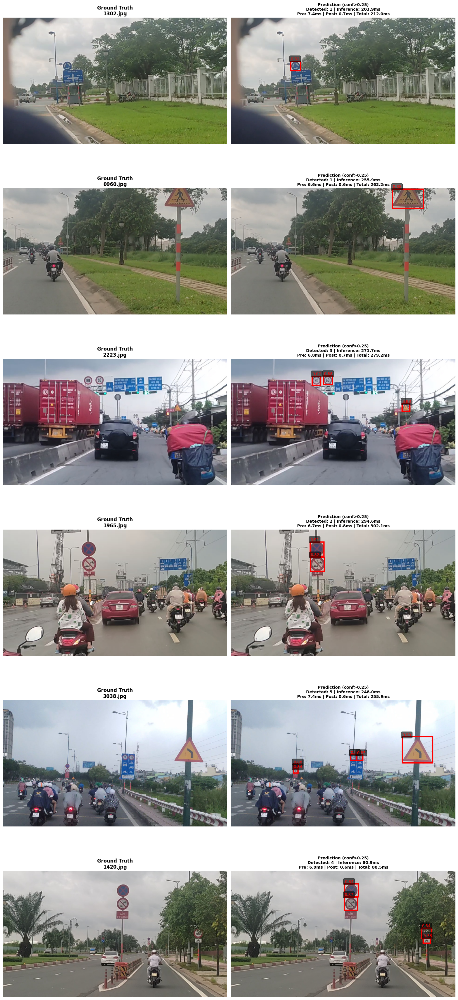


⏱️  Inference Timing Statistics (6 images):
   Average: 225.85ms (±70.36ms)
   Min: 80.95ms | Max: 294.62ms
   FPS: 4.4
✅ Saved visualization to: viz/model.ncnn_ncnn_visualization.png


'viz/model.ncnn_ncnn_visualization.png'

In [33]:
visualize_predictions_ncnn(
    param_path="./convert/model/yolo5/yolo5_ncnn_model/model.ncnn.param",
    bin_path="./convert/model/yolo5/yolo5_ncnn_model/model.ncnn.bin",
    data_yaml=data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    input_size=(640, 640),
    input_name="in0",    
    output_name="out0",  
    use_gpu=False,           
    num_threads=4
)

### YOLO8

In [34]:
pt_path = "./weight/yolo8.pt"
work_dir = "convert/model/yolo8"

# --- Tạo thư mục đích ---
os.makedirs(work_dir, exist_ok=True)

pt_copy_path = os.path.join(work_dir, "yolo8.pt")
shutil.copy(pt_path, pt_copy_path)
model = YOLO(pt_copy_path)
model.export(format="ncnn", imgsz=640)
os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from 'convert/model/yolo8/yolo8.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (6.0 MB)

NCNN: starting export with NCNN 1.0.20250916 and PNNX 20251031...


pnnxparam = convert/model/yolo8/yolo8_ncnn_model/model.pnnx.param
pnnxbin = convert/model/yolo8/yolo8_ncnn_model/model.pnnx.bin
pnnxpy = convert/model/yolo8/yolo8_ncnn_model/model_pnnx.py
pnnxonnx = convert/model/yolo8/yolo8_ncnn_model/model.pnnx.onnx
ncnnparam = convert/model/yolo8/yolo8_ncnn_model/model.ncnn.param
ncnnbin = convert/model/yolo8/yolo8_ncnn_model/model.ncnn.bin
ncnnpy = convert/model/yolo8/yolo8_ncnn_model/model_ncnn.py
fp16 = 0
optlevel = 2
device = cpu
inputshape = [1,3,640,640]f32
inputshape2 = 
customop = 
moduleop = 
get inputshape from traced inputs
inputshape = [1,3,640,640]f32
############# pass_level0
inline module = ultralytics.nn.modules.block.Bottleneck
inline module = ultralytics.nn.modules.block.C2f
inline module = ultralytics.nn.modules.block.DFL
inline module = ultralytics.nn.modules.block.SPPF
inline module = ultralytics.nn.modules.conv.Concat
inline module = ultralytics.nn.modules.conv.Conv
inline module = ultralytics.nn.modules.head.Detect
inline modu

NCNN: export success ✅ 5.7s, saved as 'convert/model/yolo8/yolo8_ncnn_model' (11.7 MB)

Export complete (6.8s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo8
Predict:         yolo predict task=detect model=convert/model/yolo8/yolo8_ncnn_model imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo8/yolo8_ncnn_model imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from model.ncnn.param
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
🖥️  Device: CPU (4 threads)
⏳ Loading model with NCNN...
✅ Loaded NCNN model successfully
   Param: ./convert/model/yolo8/yolo8_ncnn_model/model.ncnn.param
   Bin: ./convert/model/yolo8/yolo8_ncnn_model/model.ncnn.bin
   Input blob: in0
   Output blob: out0

⏱️  Processing images...
   [1/6] 97030.jpg
      Inference: 159.4ms | Pre: 11.6ms | Post: 0.5ms | Total: 171.4ms | Detected: 1
   [2/6] 63472.jpg
      Inference: 70.7ms | Pre: 8.8ms | Post: 0.5ms | Total: 80.0ms | Detected: 1
   [3/6] 50161.jpg
      Inference: 85.0ms | Pre: 8.8ms | Post: 1.2ms | Total: 95.1ms | Detected: 1
   [4/6] 79464.jpg
      Inference: 103.1ms | Pre: 10.2ms | Post: 0.7ms | Total: 114.0ms | Detected: 5
   [5/6] 59005.jpg
      Inference: 125.5ms | Pre: 9.9ms | Post: 0.6ms | Total: 136.0ms | Detected: 2
   [6/6] 72633.jpg
      Inference: 515.1ms | Pre: 10.1ms | Post: 0.5ms | Total: 525.7ms | Detected: 2

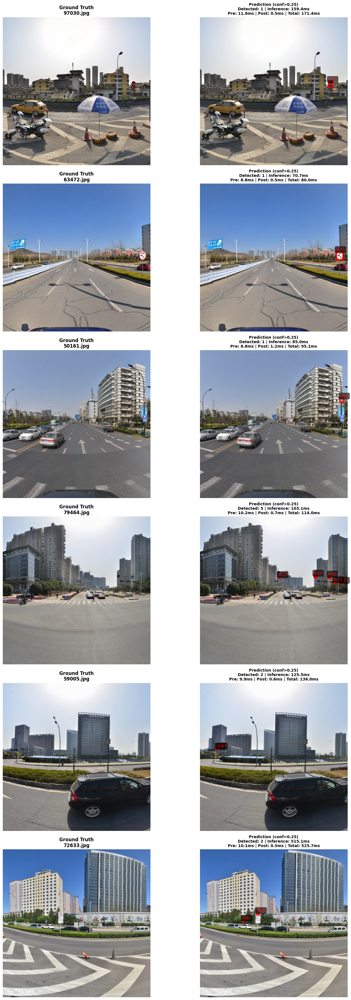


⏱️  Inference Timing Statistics (6 images):
   Average: 176.45ms (±154.11ms)
   Min: 70.67ms | Max: 515.09ms
   FPS: 5.7
✅ Saved visualization to: viz/model.ncnn_ncnn_visualization.png


'viz/model.ncnn_ncnn_visualization.png'

In [15]:
visualize_predictions_ncnn(
    param_path="./convert/model/yolo8/yolo8_ncnn_model/model.ncnn.param",
    bin_path="./convert/model/yolo8/yolo8_ncnn_model/model.ncnn.bin",
    data_yaml=data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    input_size=(640, 640),
    input_name="in0",    
    output_name="out0",  
    use_gpu=False,           
    num_threads=4
)

### YOLO11

In [35]:
pt_path = "./weight/yolo11.pt"
work_dir = "convert/model/yolo11"

# --- Tạo thư mục đích ---
os.makedirs(work_dir, exist_ok=True)

pt_copy_path = os.path.join(work_dir, "yolo11.pt")
shutil.copy(pt_path, pt_copy_path)
model = YOLO(pt_copy_path)
model.export(format="ncnn", imgsz=640)
os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs

PyTorch: starting from 'convert/model/yolo11/yolo11.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.2 MB)

NCNN: starting export with NCNN 1.0.20250916 and PNNX 20251031...


pnnxparam = convert/model/yolo11/yolo11_ncnn_model/model.pnnx.param
pnnxbin = convert/model/yolo11/yolo11_ncnn_model/model.pnnx.bin
pnnxpy = convert/model/yolo11/yolo11_ncnn_model/model_pnnx.py
pnnxonnx = convert/model/yolo11/yolo11_ncnn_model/model.pnnx.onnx
ncnnparam = convert/model/yolo11/yolo11_ncnn_model/model.ncnn.param
ncnnbin = convert/model/yolo11/yolo11_ncnn_model/model.ncnn.bin
ncnnpy = convert/model/yolo11/yolo11_ncnn_model/model_ncnn.py
fp16 = 0
optlevel = 2
device = cpu
inputshape = [1,3,640,640]f32
inputshape2 = 
customop = 
moduleop = 
get inputshape from traced inputs
inputshape = [1,3,640,640]f32
############# pass_level0
inline module = torch.nn.modules.linear.Identity
inline module = ultralytics.nn.modules.block.Attention
inline module = ultralytics.nn.modules.block.Bottleneck
inline module = ultralytics.nn.modules.block.C2PSA
inline module = ultralytics.nn.modules.block.C3k
inline module = ultralytics.nn.modules.block.C3k2
inline module = ultralytics.nn.modules.blo

NCNN: export success ✅ 8.1s, saved as 'convert/model/yolo11/yolo11_ncnn_model' (10.1 MB)

Export complete (9.1s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo11
Predict:         yolo predict task=detect model=convert/model/yolo11/yolo11_ncnn_model imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo11/yolo11_ncnn_model imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from model.ncnn.param
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
🖥️  Device: CPU (4 threads)
⏳ Loading model with NCNN...
✅ Loaded NCNN model successfully
   Param: ./convert/model/yolo11/yolo11_ncnn_model/model.ncnn.param
   Bin: ./convert/model/yolo11/yolo11_ncnn_model/model.ncnn.bin
   Input blob: in0
   Output blob: out0

⏱️  Processing images...
   [1/6] 84269.jpg
      Inference: 66.2ms | Pre: 9.0ms | Post: 0.3ms | Total: 75.4ms | Detected: 0
   [2/6] 72994.jpg
      Inference: 65.4ms | Pre: 8.7ms | Post: 0.5ms | Total: 74.6ms | Detected: 1
   [3/6] 64226.jpg
      Inference: 64.1ms | Pre: 8.7ms | Post: 0.5ms | Total: 73.3ms | Detected: 1
   [4/6] 4863.jpg
      Inference: 76.2ms | Pre: 8.8ms | Post: 0.6ms | Total: 85.6ms | Detected: 6
   [5/6] 89023.jpg
      Inference: 64.6ms | Pre: 8.6ms | Post: 0.5ms | Total: 73.7ms | Detected: 1
   [6/6] 10227.jpg
      Inference: 64.2ms | Pre: 8.9ms | Post: 0.6ms | Total: 73.7ms | Detected: 3


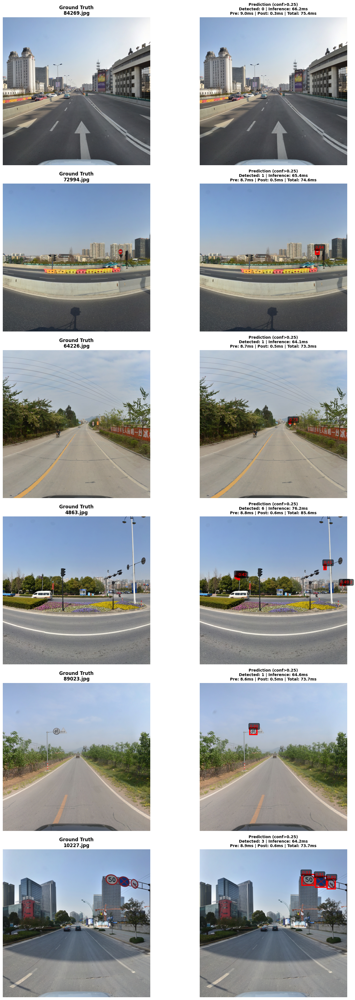


⏱️  Inference Timing Statistics (6 images):
   Average: 66.80ms (±4.29ms)
   Min: 64.12ms | Max: 76.25ms
   FPS: 15.0
✅ Saved visualization to: viz/model.ncnn_ncnn_visualization.png


'viz/model.ncnn_ncnn_visualization.png'

In [18]:
visualize_predictions_ncnn(
    param_path="./convert/model/yolo11/yolo11_ncnn_model/model.ncnn.param",
    bin_path="./convert/model/yolo11/yolo11_ncnn_model/model.ncnn.bin",
    data_yaml=data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    input_size=(640, 640),
    input_name="in0",    
    output_name="out0",  
    use_gpu=False,           
    num_threads=4
)

### YOLO_Plus

In [36]:
pt_path = "./weight/yolo_plus/yolo_plus_v2.pt"
work_dir = "convert/model/yolo_plus"

# --- Tạo thư mục đích ---
os.makedirs(work_dir, exist_ok=True)

pt_copy_path = os.path.join(work_dir, "yolo_plus.pt")
shutil.copy(pt_path, pt_copy_path)
model = YOLO(pt_copy_path)
model.export(format="ncnn", imgsz=640)
os.remove(pt_copy_path)

Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
YOLO_plus_v1 summary (fused): 72 layers, 966,355 parameters, 0 gradients, 2.8 GFLOPs

PyTorch: starting from 'convert/model/yolo_plus/yolo_plus.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (2.1 MB)

NCNN: starting export with NCNN 1.0.20250916 and PNNX 20251031...


pnnxparam = convert/model/yolo_plus/yolo_plus_ncnn_model/model.pnnx.param
pnnxbin = convert/model/yolo_plus/yolo_plus_ncnn_model/model.pnnx.bin
pnnxpy = convert/model/yolo_plus/yolo_plus_ncnn_model/model_pnnx.py
pnnxonnx = convert/model/yolo_plus/yolo_plus_ncnn_model/model.pnnx.onnx
ncnnparam = convert/model/yolo_plus/yolo_plus_ncnn_model/model.ncnn.param
ncnnbin = convert/model/yolo_plus/yolo_plus_ncnn_model/model.ncnn.bin
ncnnpy = convert/model/yolo_plus/yolo_plus_ncnn_model/model_ncnn.py
fp16 = 0
optlevel = 2
device = cpu
inputshape = [1,3,640,640]f32
inputshape2 = 
customop = 
moduleop = 
get inputshape from traced inputs
inputshape = [1,3,640,640]f32
############# pass_level0
inline module = ultralytics.nn.modules.block.Bottleneck
inline module = ultralytics.nn.modules.block.C2f
inline module = ultralytics.nn.modules.block.DFL
inline module = ultralytics.nn.modules.block.SPPF
inline module = ultralytics.nn.modules.conv.Concat
inline module = ultralytics.nn.modules.conv.Conv
inline

NCNN: export success ✅ 6.2s, saved as 'convert/model/yolo_plus/yolo_plus_ncnn_model' (3.9 MB)

Export complete (7.0s)
Results saved to /home/pi5/TrafficSign/VNTSR/convert/model/yolo_plus
Predict:         yolo predict task=detect model=convert/model/yolo_plus/yolo_plus_ncnn_model imgsz=640  
Validate:        yolo val task=detect model=convert/model/yolo_plus/yolo_plus_ncnn_model imgsz=640 data=/kaggle/working/data.yaml  
Visualize:       https://netron.app



🎨 Visualizing 6 images from model.ncnn.param
📊 Confidence threshold: 0.25
📐 Model input size: (640, 640)
🖥️  Device: CPU (4 threads)
⏳ Loading model with NCNN...
✅ Loaded NCNN model successfully
   Param: ./convert/model/yolo_plus/yolo_plus_ncnn_model/model.ncnn.param
   Bin: ./convert/model/yolo_plus/yolo_plus_ncnn_model/model.ncnn.bin
   Input blob: in0
   Output blob: out0

⏱️  Processing images...
   [1/6] 91365.jpg
      Inference: 198.1ms | Pre: 9.2ms | Post: 0.2ms | Total: 207.5ms | Detected: 0
   [2/6] 41091.jpg
      Inference: 221.8ms | Pre: 9.6ms | Post: 0.7ms | Total: 232.0ms | Detected: 1
   [3/6] 70510.jpg
      Inference: 210.1ms | Pre: 10.0ms | Post: 0.7ms | Total: 220.8ms | Detected: 1
   [4/6] 41568.jpg
      Inference: 211.1ms | Pre: 9.5ms | Post: 0.9ms | Total: 221.5ms | Detected: 5
   [5/6] 22693.jpg
      Inference: 193.0ms | Pre: 9.3ms | Post: 0.9ms | Total: 203.3ms | Detected: 6
   [6/6] 18661.jpg
      Inference: 96.6ms | Pre: 9.7ms | Post: 0.6ms | Total: 106.

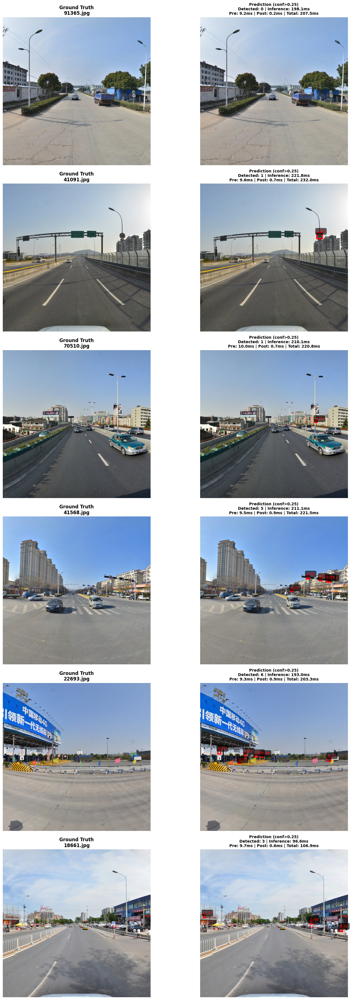


⏱️  Inference Timing Statistics (6 images):
   Average: 188.45ms (±42.11ms)
   Min: 96.62ms | Max: 221.77ms
   FPS: 5.3
✅ Saved visualization to: viz/model.ncnn_ncnn_visualization.png


'viz/model.ncnn_ncnn_visualization.png'

In [20]:
visualize_predictions_ncnn(
    param_path="./convert/model/yolo_plus/yolo_plus_ncnn_model/model.ncnn.param",
    bin_path="./convert/model/yolo_plus/yolo_plus_ncnn_model/model.ncnn.bin",
    data_yaml=data_yaml,
    num_samples=6,
    conf_threshold=0.25,
    input_size=(640, 640),
    input_name="in0",    
    output_name="out0",  
    use_gpu=False,           
    num_threads=4
)

# EVAL

In [7]:
# Hàm benchmark PyTorch
def evaluate_model(model_path, data_yaml, device="cpu", eval_type="Self", imgsz=640, batch=4, num_threads=8, model_name=None):
    print(f"\n📈 [{eval_type}] Evaluating (PyTorch): {os.path.basename(model_path)} on {data_yaml}")

    # --- Cố định threading ---
    os.environ["OMP_NUM_THREADS"] = str(num_threads)
    os.environ["MKL_NUM_THREADS"] = str(num_threads)
    torch.set_num_threads(num_threads)

    # --- Load model YOLO ---
    model = YOLO(model_path)
    model.to(device)

    # --- Validation phase ---
    t0 = time.time()
    metrics = model.val(data=data_yaml, imgsz=imgsz, batch=batch, device=device, verbose=False)
    eval_time = time.time() - t0

    # --- Extract YOLO metrics ---
    map50 = round(metrics.box.map50, 4)
    map95 = round(metrics.box.map, 4)
    prec = round(metrics.box.mp, 4)
    recall = round(metrics.box.mr, 4)
    f1 = round(2 * (prec * recall) / (prec + recall + 1e-9), 4)
    acc = round((prec + recall) / 2, 4)

    # --- Benchmark inference ---
    dummy = torch.randn(1, 3, imgsz, imgsz).to(device)
    warmup, runs = 5, 20
    for _ in range(warmup):
        _ = model.model(dummy)
    t_inf = time.time()
    for _ in range(runs):
        _ = model.model(dummy)
    torch.cuda.synchronize() if device == "cuda" else None
    infer_time = (time.time() - t_inf) / runs
    fps = round(1.0 / infer_time, 2)

    return {
        "Model Name": model_name,
        "Backend": "PyTorch",
        "Eval Type": eval_type,
        "Precision": prec,
        "Recall": recall,
        "F1-score": f1,
        "Accuracy": acc,
        "mAP@50": map50,
        "mAP@50-95": map95,
        "Eval Time (s)": round(eval_time, 2),
        "Infer Time (s/img)": round(infer_time, 4)
    }

# Hàm benchmark ONNX
def evaluate_onnx(onnx_path, data_yaml, eval_type="Self", device="cpu", imgsz=640, batch=4, num_threads=8, model_name=None):
    print(f"\n📈 [{eval_type}] Evaluating (ONNX): {os.path.basename(onnx_path)} on {data_yaml}")

    # --- Setup threading & provider ---
    os.environ["OMP_NUM_THREADS"] = str(num_threads)
    os.environ["MKL_NUM_THREADS"] = str(num_threads)
    providers = ["CPUExecutionProvider"] if device == "cpu" else ["CUDAExecutionProvider"]

    # --- Load YOLO ONNX for evaluation ---
    model = YOLO(onnx_path, task="detect")

    # --- Validation phase ---
    t0 = time.time()
    metrics = model.val(data=data_yaml, split="val", imgsz=imgsz, batch=batch, device=device, verbose=False)
    eval_time = time.time() - t0

    # --- Extract metrics ---
    prec = round(metrics.results_dict.get("metrics/precision(B)", 0), 4)
    recall = round(metrics.results_dict.get("metrics/recall(B)", 0), 4)
    map50 = round(metrics.results_dict.get("metrics/mAP50(B)", 0), 4)
    map5095 = round(metrics.results_dict.get("metrics/mAP50-95(B)", 0), 4)
    f1 = round(2 * (prec * recall) / (prec + recall + 1e-9), 4)
    acc = round((prec + recall) / 2, 4)

    # --- Benchmark inference using onnxruntime ---
    sess_options = ort.SessionOptions()
    sess_options.intra_op_num_threads = num_threads
    sess_options.graph_optimization_level = ort.GraphOptimizationLevel.ORT_ENABLE_ALL
    session = ort.InferenceSession(onnx_path, sess_options, providers=providers)
    

    input_name = session.get_inputs()[0].name
    dummy = np.random.randn(1, 3, imgsz, imgsz).astype(np.float32)

    # Warmup + benchmark
    warmup, runs = 5, 20
    for _ in range(warmup):
        _ = session.run(None, {input_name: dummy})
    t_inf = time.time()
    for _ in range(runs):
        _ = session.run(None, {input_name: dummy})
    infer_time = (time.time() - t_inf) / runs
    fps = round(1.0 / infer_time, 2)

    return {
        "Model Name": model_name,
        "Backend": "ONNX",
        "Eval Type": eval_type,
        "Precision": prec,
        "Recall": recall,
        "F1-score": f1,
        "Accuracy": acc,
        "mAP@50": map50,
        "mAP@50-95": map5095,
        "Eval Time (s)": round(eval_time, 2),
        "Infer Time (s/img)": round(infer_time, 4)

    }

# Hàm benchmark OpenVINO
def evaluate_openvino(openvino_path, data_yaml, eval_type="Self", device="cpu", imgsz=640, batch=1, num_threads=4, model_name=None):
    """
    Benchmark OpenVINO model (optimized for Raspberry Pi 5 ARM64)
    
    Args:
        openvino_path: Path to folder containing .xml, .bin files
        data_yaml: Path to dataset YAML
        eval_type: "Self" or "Cross"
        device: "cpu" only (OpenVINO on Pi doesn't support GPU)
        imgsz: Input image size
        batch: Batch size (recommend 1 for Pi)
        num_threads: Number of CPU threads (4 for Pi 5)
    """
    print(f"\n📈 [{eval_type}] Evaluating (OpenVINO): {os.path.basename(openvino_path)} on {data_yaml}")
    
    try:
        from openvino.runtime import Core
    except ImportError:
        print("❌ OpenVINO not installed! Install: pip install openvino")
        return None

    # --- Setup threading ---
    os.environ["OMP_NUM_THREADS"] = str(num_threads)
    os.environ["MKL_NUM_THREADS"] = str(num_threads)
    
    # --- Find .xml file in folder ---
    openvino_folder = Path(openvino_path)
    xml_files = list(openvino_folder.glob("*.xml"))
    
    if not xml_files:
        print(f"❌ No .xml file found in {openvino_path}")
        return None
    
    model_xml = str(xml_files[0])
    print(f"📦 Found model: {model_xml}")
    
    # --- Load YOLO OpenVINO for evaluation ---
    try:
        model = YOLO(openvino_path, task="detect")
    except Exception as e:
        print(f"⚠️ YOLO direct load failed: {e}")
        print("📝 Will use OpenVINO Core directly for inference benchmark")
        model = None
    
    # --- Validation phase (if YOLO wrapper works) ---
    eval_time = 0
    prec = recall = map50 = map5095 = f1 = acc = 0
    
    if model is not None:
        try:
            t0 = time.time()
            metrics = model.val(
                data=data_yaml, 
                split="val", 
                imgsz=imgsz, 
                batch=batch, 
                device=device, 
                verbose=False
            )
            eval_time = time.time() - t0
            
            # --- Extract metrics ---
            prec = round(metrics.results_dict.get("metrics/precision(B)", 0), 4)
            recall = round(metrics.results_dict.get("metrics/recall(B)", 0), 4)
            map50 = round(metrics.results_dict.get("metrics/mAP50(B)", 0), 4)
            map5095 = round(metrics.results_dict.get("metrics/mAP50-95(B)", 0), 4)
            f1 = round(2 * (prec * recall) / (prec + recall + 1e-9), 4)
            acc = round((prec + recall) / 2, 4)
            print(f"✅ Validation completed: mAP@50={map50}")
        except Exception as e:
            print(f"⚠️ Validation failed: {e}")
            print("📝 Skipping validation, will only benchmark inference speed")
    
    # --- Benchmark inference using OpenVINO Core ---
    print("🔧 Loading OpenVINO model for inference benchmark...")
    ie = Core()
    
    # ARM optimization for Pi 5
    config = {
        "PERFORMANCE_HINT": "LATENCY",  # Optimize for low latency
        "NUM_STREAMS": "1",
        "INFERENCE_NUM_THREADS": str(num_threads),
        "ENABLE_CPU_PINNING": "YES",
        "INFERENCE_PRECISION_HINT": "f32"  # Pi 5 doesn't have good fp16 support
    }
    
    compiled_model = ie.compile_model(model=model_xml, device_name="CPU", config=config)
    infer_request = compiled_model.create_infer_request()
    
    # Get input tensor info
    input_layer = compiled_model.input(0)
    input_shape = input_layer.shape
    print(f"📐 Model input shape: {input_shape}")
    
    # Prepare dummy input
    dummy = np.random.randn(1, 3, imgsz, imgsz).astype(np.float32)
    
    # Warmup
    warmup, runs = 5, 20
    print(f"🔥 Warming up {warmup} iterations...")
    for _ in range(warmup):
        infer_request.infer({0: dummy})
    
    # Benchmark
    print(f"⏱️ Benchmarking {runs} iterations...")
    t_inf = time.time()
    for _ in range(runs):
        infer_request.infer({0: dummy})
    infer_time = (time.time() - t_inf) / runs
    fps = round(1.0 / infer_time, 2)
    print(f"✅ Inference time: {infer_time*1000:.2f} ms/image")
    
    return {
        "Model Name": model_name,
        "Backend": "OpenVINO",
        "Eval Type": eval_type,
        "Precision": prec,
        "Recall": recall,
        "F1-score": f1,
        "Accuracy": acc,
        "mAP@50": map50,
        "mAP@50-95": map5095,
        "Eval Time (s)": round(eval_time, 2),
        "Infer Time (s/img)": round(infer_time, 4)
    }

def evaluate_ncnn(ncnn_folder, data_yaml, eval_type="Self", imgsz=640, num_threads=4, model_name=None):
    """
    Benchmark NCNN model (inference bằng runtime thuần NCNN, val dùng YOLO wrapper)
    """
    print(f"\n📈 [{eval_type}] Evaluating (NCNN): {os.path.basename(ncnn_folder)} on {data_yaml}")

    # --- Load model YOLO (wrapper) để tính mAP ---
    try:
        model = YOLO(ncnn_folder, task="detect")
        t0 = time.time()
        metrics = model.val(data=data_yaml, imgsz=imgsz, split="val", batch=1, device="cpu", verbose=False)
        eval_time = time.time() - t0

        prec = round(metrics.results_dict.get("metrics/precision(B)", 0), 4)
        recall = round(metrics.results_dict.get("metrics/recall(B)", 0), 4)
        map50 = round(metrics.results_dict.get("metrics/mAP50(B)", 0), 4)
        map5095 = round(metrics.results_dict.get("metrics/mAP50-95(B)", 0), 4)
        f1 = round(2 * (prec * recall) / (prec + recall + 1e-9), 4)
        acc = round((prec + recall) / 2, 4)
        print(f"✅ Validation done: mAP@50={map50}")
    except Exception as e:
        print(f"⚠️ Validation failed with YOLO wrapper: {e}")
        prec = recall = map50 = map5095 = f1 = acc = 0
        eval_time = 0

    # --- Benchmark inference bằng NCNN thuần ---
    print("🔧 Benchmarking raw NCNN inference...")
    param_path = Path(ncnn_folder) / "model.ncnn.param"
    bin_path = Path(ncnn_folder) / "model.ncnn.bin"
    if not param_path.exists() or not bin_path.exists():
        print(f"❌ Missing NCNN files in {ncnn_folder}")
        return None

    net = ncnn.Net()
    net.opt.use_vulkan_compute = False
    net.opt.num_threads = num_threads
    net.load_param(str(param_path))
    net.load_model(str(bin_path))

    # --- Dummy input ---
    dummy = np.random.randn(1, 3, imgsz, imgsz).astype(np.float32)

    # --- Warmup ---
    warmup, runs = 5, 20
    for _ in range(warmup):
        ex = net.create_extractor()
        ex.input("in0", ncnn.Mat(dummy))
        _, _ = ex.extract("out0")  

    # --- Benchmark ---
    t_inf = time.time()
    for _ in range(runs):
        ex = net.create_extractor()
        ex.input("in0", ncnn.Mat(dummy))
        _, _ = ex.extract("out0")
    infer_time = (time.time() - t_inf) / runs
    fps = round(1.0 / infer_time, 2)

    print(f"✅ NCNN Inference time: {infer_time*1000:.2f} ms/image")

    return {
        "Model Name": model_name,
        "Backend": "NCNN",
        "Eval Type": eval_type,
        "Precision": prec,
        "Recall": recall,
        "F1-score": f1,
        "Accuracy": acc,
        "mAP@50": map50,
        "mAP@50-95": map5095,
        "Eval Time (s)": round(eval_time, 2),
        "Infer Time (s/img)": round(infer_time, 4)
    }


## Eval

In [8]:

# --- Định nghĩa model paths ---
models_pt = {
    "YOLO5n": "./weight/yolo5.pt",
    "YOLO8n": "./weight/yolo8.pt",
    "YOLO11n": "./weight/yolo11.pt",
    "yolo_custom": "./weight/yolo_plus/yolo_plus_v2.pt",
}

models_onnx = {
    "YOLO5n": "./convert/model/yolo5/yolo5.onnx",
    "YOLO8n": "./convert/model/yolo8/yolo8.onnx",
    "YOLO11n": "./convert/model/yolo11/yolo11.onnx",
    "yolo_custom": "./convert/model/yolo_plus/yolo_plus.onnx",

}

models_openvino = {
    "YOLO5n": "./convert/model/yolo5/yolo5_openvino_model",
    "YOLO8n": "./convert/model/yolo8/yolo8_openvino_model",
    "YOLO11n": "./convert/model/yolo11/yolo11_openvino_model",
    "yolo_custom": "./convert/model/yolo_plus/yolo_plus_openvino_model",
}

models_ncnn = {
    "YOLO5n": "./convert/model/yolo5/yolo5_ncnn_model",
    "YOLO8n": "./convert/model/yolo8/yolo8_ncnn_model",
    "YOLO11n": "./convert/model/yolo11/yolo11_ncnn_model",
    "yolo_custom": "./convert/model/yolo_plus/yolo_plus_ncnn_model",
}
results = []

# # --- Benchmark ONNX ---
# for model_name, model_path in models_onnx.items():
#     print(f"\n🚀 Running ONNX Benchmark for {model_name}")
#     results.append(
#         evaluate_onnx(model_path, data_yaml, eval_type=f"{model_name}", device="cpu", model_name=model_name)
#     )

# --- Benchmark OpenVINO ---
for model_name, model_path in models_openvino.items():
    print(f"\n🚀 Running OpenVINO Benchmark for {model_name}")
    result = evaluate_openvino(model_path, data_yaml, eval_type=f"{model_name}", device="cpu", batch=1, num_threads=4, model_name=model_name)
    if result:
        results.append(result)

# # --- Benchmark NCNN ---
# for model_name, model_path in models_ncnn.items():
#     print(f"\n🚀 Running NCNN Benchmark for {model_name}")
#     result = evaluate_ncnn(model_path, data_yaml, eval_type=f"{model_name}", imgsz=640, num_threads=4, model_name=model_name)
#     if result:
#         results.append(result)

# --- Lưu kết quả ---
df = pd.DataFrame(results)
save_csv = "./Eval/vntsr_metric_results_openvino_yolo_v5_v8_v11_yolo_custom.csv"
df.to_csv(save_csv, index=False)
print(f"\n✅ Saved benchmark results to: {save_csv}")


🚀 Running OpenVINO Benchmark for YOLO5n

📈 [YOLO5n] Evaluating (OpenVINO): yolo5_openvino_model on ./Dataset/Detect/data_detect_vntsr/data.yaml
📦 Found model: convert/model/yolo5/yolo5_openvino_model/yolo5.xml
Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
Loading ./convert/model/yolo5/yolo5_openvino_model for OpenVINO inference...
Using OpenVINO LATENCY mode for batch=1 inference on CPU...
Setting batch=1 input of shape (1, 3, 640, 640)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 64.4±5.7 MB/s, size: 289.1 KB)
val: Scanning /home/pi5/TrafficSign/VNTSR/Dataset/Detect/data_detect_vntsr/labels/test.cache... 639 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 639/639 1.1Mit/s 0.0ss
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 639/639 6.4it/s 1:40<0.1sss
                   all        639       1645      0.956      0.944      0.979      0.762
Speed: 3.8ms preprocess, 126.3ms inference, 0.0ms loss, 2

In [45]:
models_openvino = {
    "YOLO5n": "./convert/model/yolo5/yolo5_openvino_model",
    "YOLO8n": "./convert/model/yolo8/yolo8_openvino_model",
    "YOLO11n": "./convert/model/yolo11/yolo11_openvino_model",
    "yolo_custom": "./convert/model/yolo_plus/yolo_plus_openvino_model",
}
# --- Benchmark OpenVINO ---
for model_name, model_path in models_openvino.items():
    print(f"\n🚀 Running OpenVINO Benchmark for {model_name}")
    result = evaluate_openvino(model_path, data_yaml, eval_type=f"{model_name}", device="cpu", batch=1, num_threads=4, model_name=model_name)
    if result:
        results.append(result)
# --- Lưu kết quả ---
df = pd.DataFrame(results)
save_csv = "./Eval/vntsr_metric_results_onnx_openvino_yolo_v5_v8_v11_yolo_custom.csv"
df.to_csv(save_csv, index=False)
print(f"\n✅ Saved benchmark results to: {save_csv}")


🚀 Running OpenVINO Benchmark for YOLO5n

📈 [YOLO5n] Evaluating (OpenVINO): yolo5_openvino_model on ./Dataset/Detect/data_detect_vntsr/data.yaml
📦 Found model: convert/model/yolo5/yolo5_openvino_model/yolo5.xml
Ultralytics 8.3.227 🚀 Python-3.13.5 torch-2.9.0+cpu CPU (aarch64)
Loading ./convert/model/yolo5/yolo5_openvino_model for OpenVINO inference...
Using OpenVINO LATENCY mode for batch=1 inference on CPU...
Setting batch=1 input of shape (1, 3, 640, 640)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 62.1±15.0 MB/s, size: 246.2 KB)
val: Scanning /home/pi5/TrafficSign/VNTSR/Dataset/Detect/data_detect_vntsr/labels/test.cache... 639 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 639/639 1.1Mit/s 0.0s0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 6% ╸─────────── 40/639 8.0it/s 29.3s<1:15WARNING ⚠️ NMS time limit 2.050s exceeded
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 7% ╸─────────── 4

KeyboardInterrupt: 

## Eval result

In [44]:
display(df)

,Model Name,Backend,Eval Type,Precision,Recall,F1-score,Accuracy,mAP@50,mAP@50-95,Eval Time (s),Infer Time (s/img),FPS
0,YOLOv8n,PyTorch,YOLOv8n-Self,0.9065,0.6749,0.7737,0.7907,0.7715,0.5092,45.8300,0.0891,11.2200
1,YOLOv8n,PyTorch,YOLOv8n-Cross,0.8416,0.7523,0.7944,0.7970,0.7948,0.4654,20.1300,0.0950,10.5200
2,YOLO11n,PyTorch,YOLO11n-Self,0.8890,0.7021,0.7846,0.7956,0.7815,0.4996,50.1300,0.0958,10.4400
3,YOLO11n,PyTorch,YOLO11n-Cross,0.8316,0.7521,0.7899,0.7918,0.8024,0.4719,20.2300,0.1009,9.9100
4,YOLOv8n,ONNX,YOLOv8n-Self,0.8980,0.6769,0.7719,0.7874,0.7702,0.5105,58.2000,0.1936,5.1700
5,YOLOv8n,ONNX,YOLOv8n-Cross,0.8192,0.7691,0.7934,0.7942,0.7930,0.4640,25.1700,0.1965,5.0900
6,YOLO11n,ONNX,YOLO11n-Self,0.8890,0.7021,0.7846,0.7955,0.7815,0.4996,34.5200,0.2037,4.9100
7,YOLO11n,ONNX,YOLO11n-Cross,0.8316,0.7521,0.7899,0.7918,0.8024,0.4719,15.9700,0.1889,5.2900
8,YOLOv8n,OpenVINO,YOLOv8n-Self,0.8192,0.7691,0.7934,0.7942,0.7930,0.4640,20.9800,0.0431,23.2200
9,YOLOv8n,OpenVINO,YOLOv8n-Cross,0.8980,0.6769,0.7719,0.7874,0.7702,0.5105,47.4500,0.0393,25.4500
